In [2]:
!pip install gymnasium
!pip install opencv-python

In [1]:
import cv2
import gymnasium as gym
from gymnasium import spaces
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import numpy as np

In [2]:
class RoomVacuum(gym.Env):
    metadata = { 'render.modes': [] }
    def __init__(self):
        self.GRID_SIZE = 4
        self.observation_space = spaces.Discrete(16)
        self.action_space = spaces.Discrete(8)
        self.max_timesteps = 50

        self.timestep = 0
        self.agent_position = [0, 0]
        self.goal_position = [self.GRID_SIZE - 1, self.GRID_SIZE - 1]

        self.corner1 = [3, 0]
        self.object1 = [2, 2]
        self.object2 = [3, 2]
        self.corner2 = [0, 3]
        self.initialize_state()
    def initialize_state(self):
        self.state = np.zeros((self.GRID_SIZE, self.GRID_SIZE))

        self.state[tuple(self.agent_position)] = 1
        self.state[tuple(self.goal_position)] = 0.5
        
    def reset(self, **kwargs):
        self.agent_position = [0, 0]

        self.initialize_state()
        self.timestep = 0
        observation = self.state.flatten()
        info = {}

        return observation, info

    def get_next_action(self, current_position, action):

        if action == 0:  # right
            current_position[0] += 1
        if action == 1:  # left
            current_position[0] -= 1
        if action == 2:  # up
            current_position[1] += 1
        if action == 3:  # down
            current_position[1] -= 1
        if action == 4:  # up-right
            current_position[0] += 1
            current_position[1] += 1
        if action == 5:  # up-left
            current_position[0] -= 1
            current_position[1] += 1
        if action == 6:  # down-left
            current_position[0] -= 1
            current_position[1] -= 1
        if action == 7:  # down-right
            current_position[0] += 1
            current_position[1] -= 1

        return current_position
    
    def step(self, action):

        self.agent_position = self.get_next_action(self.agent_position, action)

        self.agent_position = np.clip(self.agent_position, 0, self.GRID_SIZE - 1)

        self.initialize_state()
        observation = self.state.flatten()

        reward = 0
        if np.array_equal(self.agent_position, self.goal_position):
            reward = 5
        if np.array_equal(self.agent_position, self.corner1) or np.array_equal(self.agent_position, self.corner2):
            reward = 2
        if np.array_equal(self.agent_position, self.object1) or np.array_equal(self.agent_position, self.object2):
            reward = -1

        self.timestep += 1
        truncated = False if (self.agent_position[0] >=0 ) & (self.agent_position[0] <= 3) & (self.agent_position[1] >=0 ) & (self.agent_position[1] <= 3) else True
        terminated = True if self.timestep >= self.max_timesteps else False

        info = {}

        return observation, reward, terminated, truncated, info

    def render(self, plot = False):
#         plt.imshow(self.state)

        fig, ax = plt.subplots(figsize=(10, 10))
        ax.set_xlim(0, 4)
        ax.set_ylim(0, 4)

        def image_plotting(position):
            plot_agent, plot_corner, plot_object, plot_goal = False, False, False, False

            if np.array_equal(position, self.agent_position):
                plot_agent = True
            if np.array_equal(position, self.object1) or np.array_equal(position, self.object2):
                plot_object = True
            if np.array_equal(position, self.corner1) or np.array_equal(position, self.corner2):
                plot_corner = True
            if np.array_equal(position, self.goal_position):
                plot_goal = True

            if plot_agent and not(plot_corner or plot_goal or plot_object):
                agent = AnnotationBbox(OffsetImage(plt.imread('./images/agent.jpeg'), zoom = 0.28), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(agent)

            elif plot_goal and not(plot_corner or plot_agent or plot_object):
                goal = AnnotationBbox(OffsetImage(plt.imread('./images/goal.jpeg'), zoom = 0.3), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(goal)

            elif plot_corner and not(plot_agent or plot_goal or plot_object):
                corner = AnnotationBbox(OffsetImage(plt.imread('./images/corner.png'), zoom = 0.1), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(corner)

            elif plot_object and not(plot_corner or plot_goal or plot_agent):
                object_ = AnnotationBbox(OffsetImage(plt.imread('./images/object.jpeg'), zoom = 0.38), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(object_)

            elif plot_object and plot_agent:
                agent_object = AnnotationBbox(OffsetImage(plt.imread('./images/agent-object.jpeg'), zoom = 0.2), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(agent_object)

            elif plot_corner and plot_agent:
                agent_corner = AnnotationBbox(OffsetImage(plt.imread('./images/agent-corner.jpeg'), zoom = 0.2), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(agent_corner)

            elif plot_goal and plot_agent:
                agent_goal = AnnotationBbox(OffsetImage(plt.imread('./images/agent-goal.jpeg'), zoom = 0.2), np.add(position, [0.5, 0.5]), frameon = False)
                ax.add_artist(agent_goal)

        state_mapping = {}
        for ind in range(self.GRID_SIZE * self.GRID_SIZE):
            state_mapping[ind] = np.asarray([ind % self.GRID_SIZE, int(np.floor(ind / self.GRID_SIZE))])

        for pos in state_mapping:
            image_plotting(state_mapping[pos])

        plt.xticks([0, 1, 2, 3, 4])
        plt.yticks([0, 1, 2, 3, 4])
        plt.grid()

        if plot:
            plt.show()
        else:
            fig.canvas.draw()
            image = np.array(fig.canvas.renderer.buffer_rgba())[:, :, :3]
            dimensions = (84, 84)

        preprocessed_image = cv2.resize(image, dimensions, interpolation = cv2.INTER_AREA)
        plt.show()
        return preprocessed_image

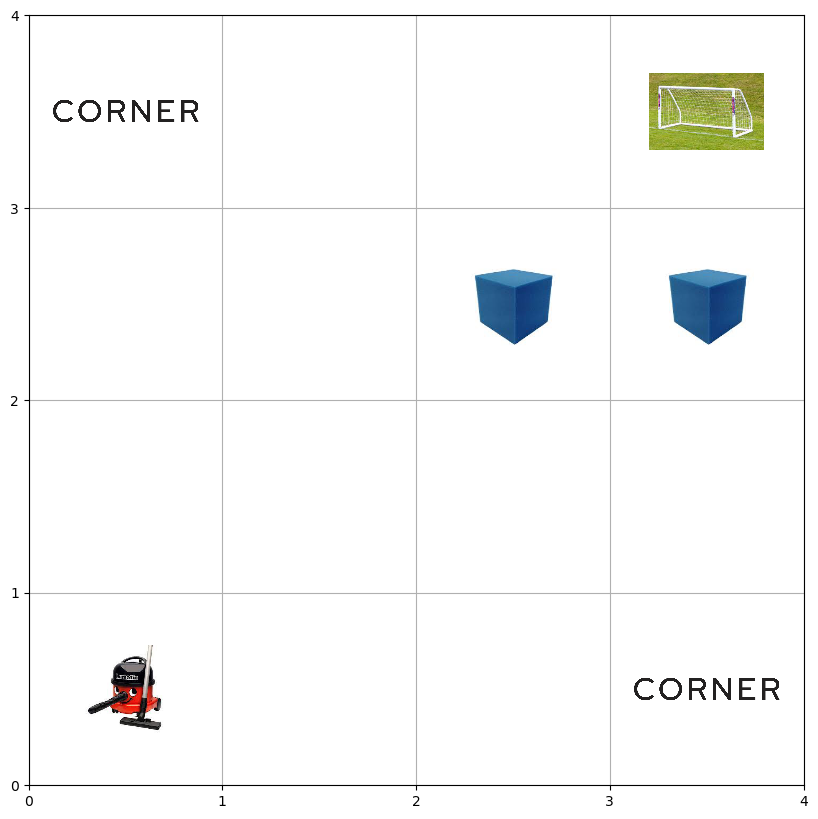

[1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.5]


In [3]:
env = RoomVacuum()

terminated, truncated = False, False
obs, info = env.reset()
env.render()
print(obs)

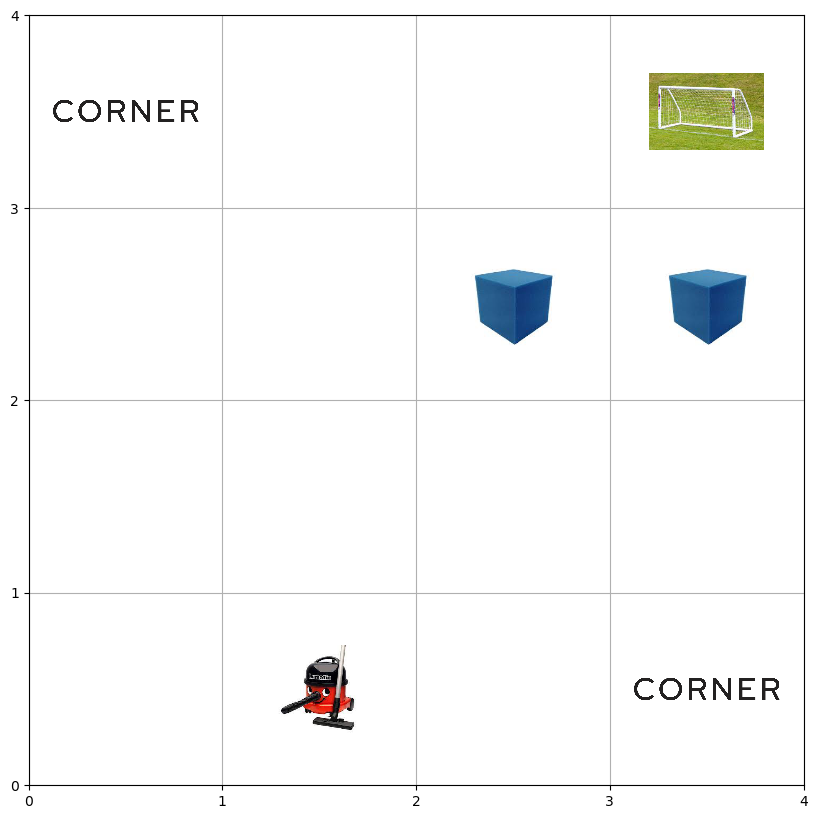

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [4]:
action = 0
observation, reward, done, truncated, info = env.step(action)
env.render()

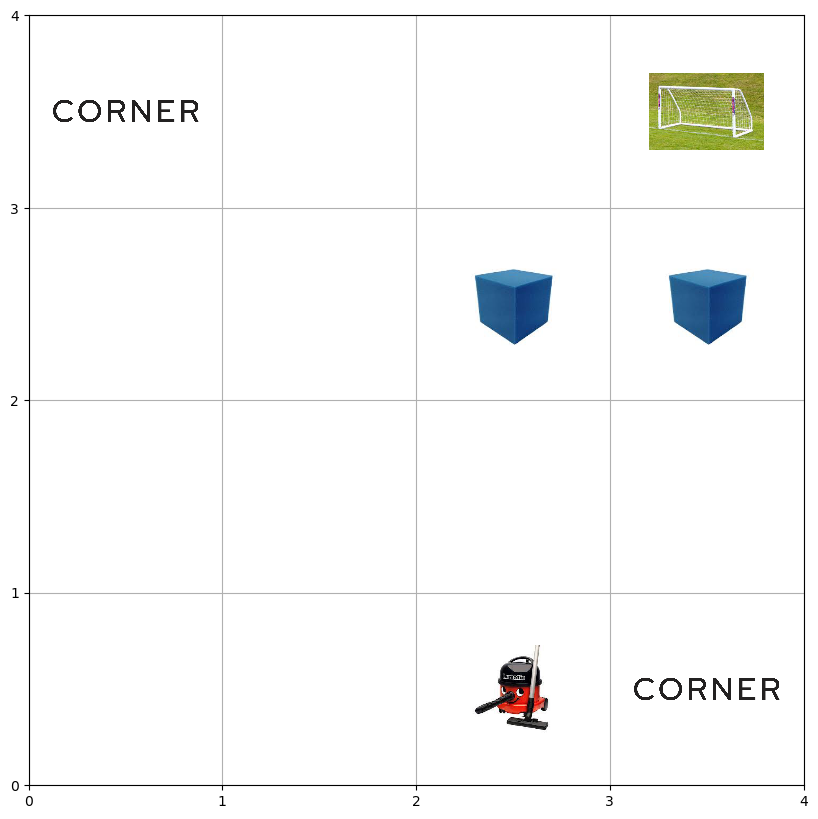

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [5]:
action = 0
observation, reward, done, truncated, info = env.step(action)
env.render()

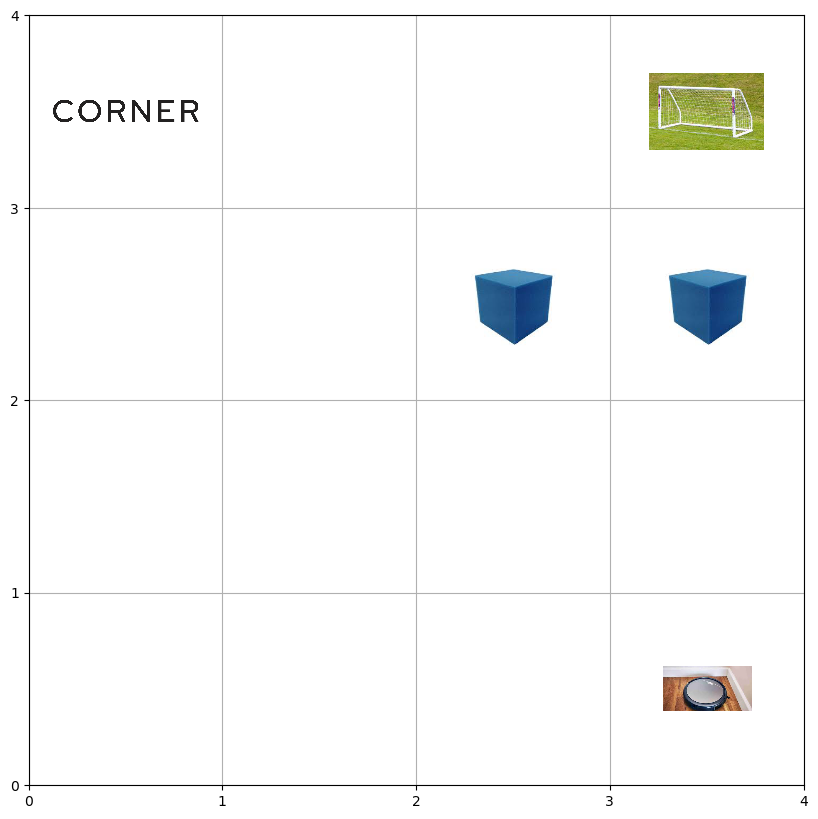

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [6]:
action = 0
observation, reward, done, truncated, info = env.step(action)
env.render()

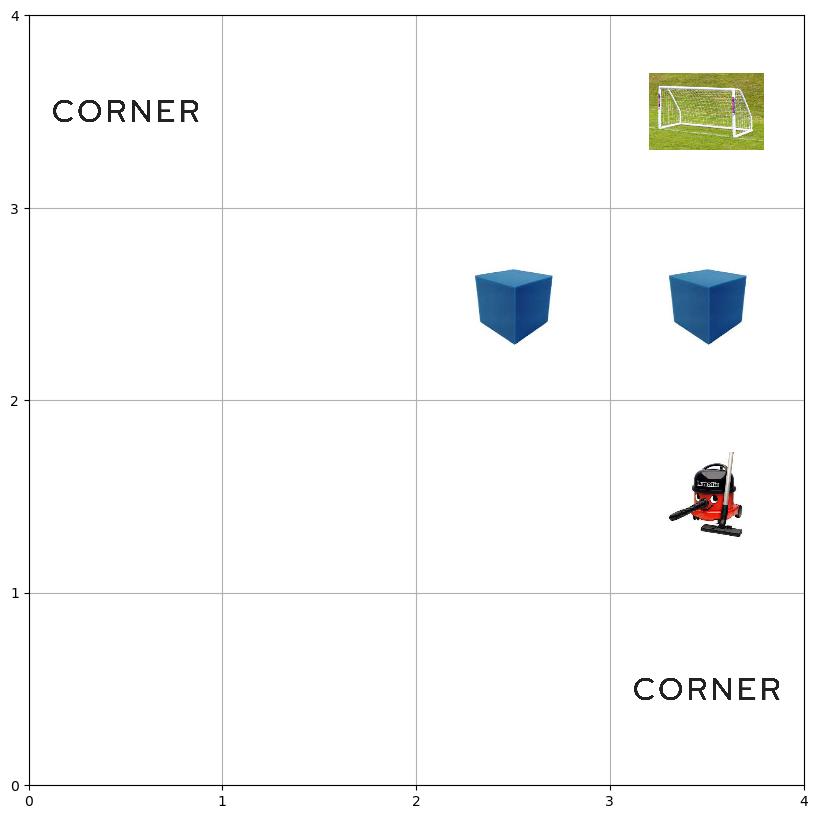

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [7]:
action = 2
observation, reward, done, truncated, info = env.step(action)
env.render()

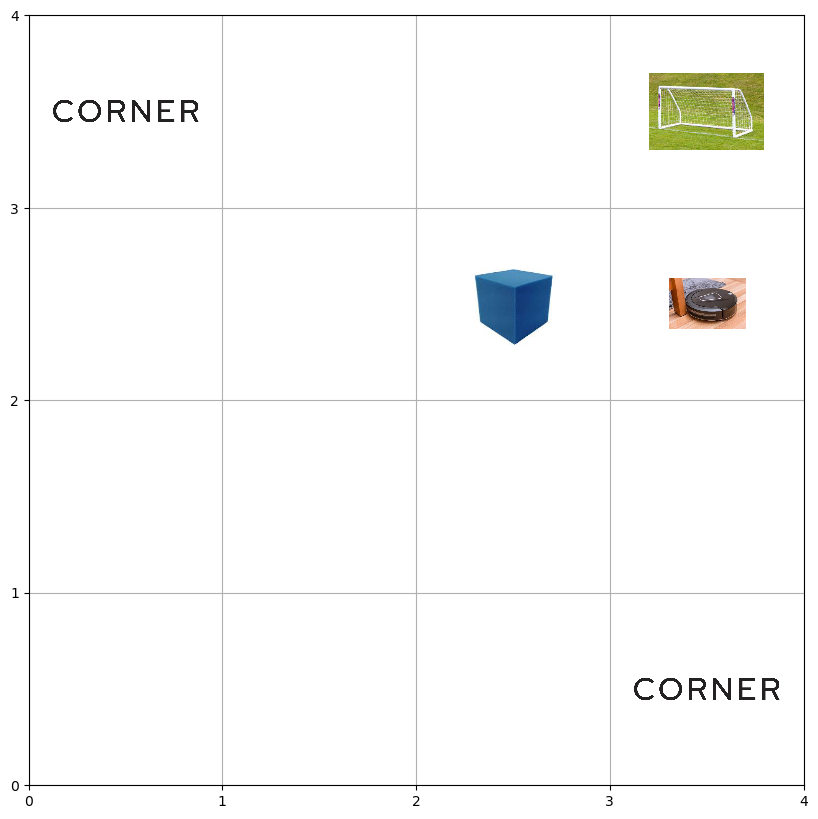

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [8]:
action = 2
observation, reward, done, truncated, info = env.step(action)
env.render()

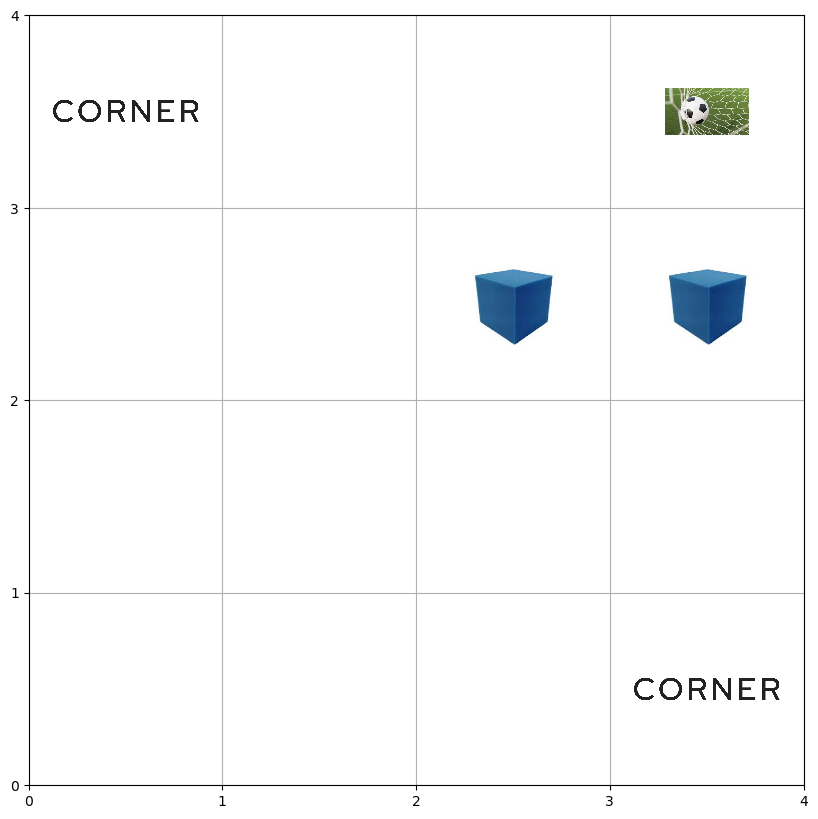

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [9]:
action = 2
observation, reward, done, truncated, info = env.step(action)
env.render()

In [10]:
class RandomAgent:
    def __init__(self, env):
        self.env = env
        self.observation_space = env.observation_space
        self.action_space = env.action_space

    def step(self, obs):
        return np.random.choice(self.action_space.n)

Action: 5 , Reward: 0 , Done: False


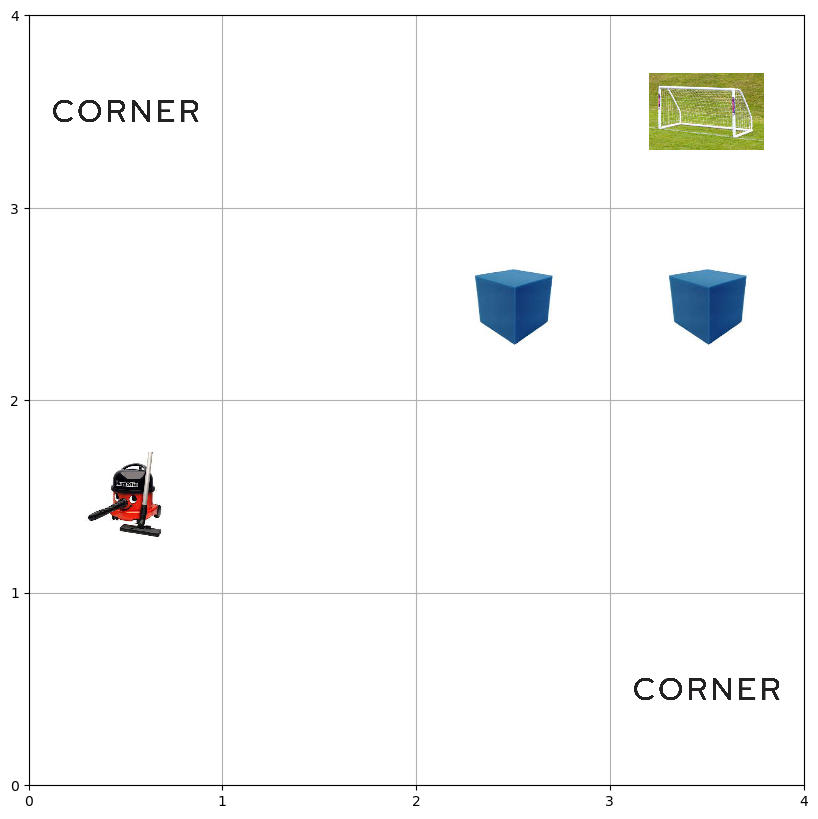

Action: 1 , Reward: 0 , Done: False


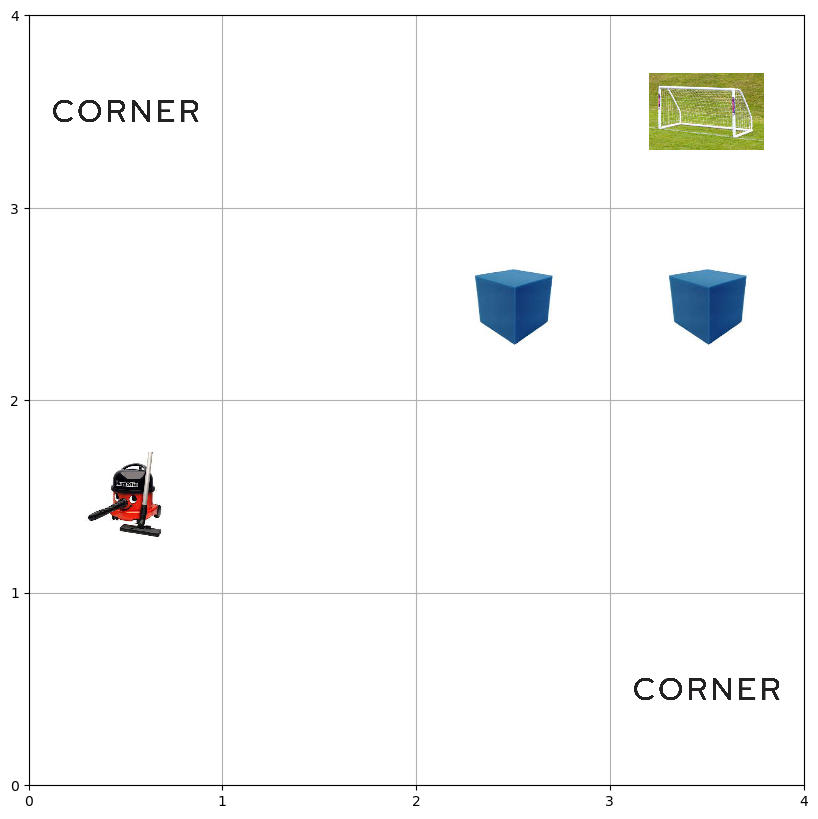

Action: 7 , Reward: 0 , Done: False


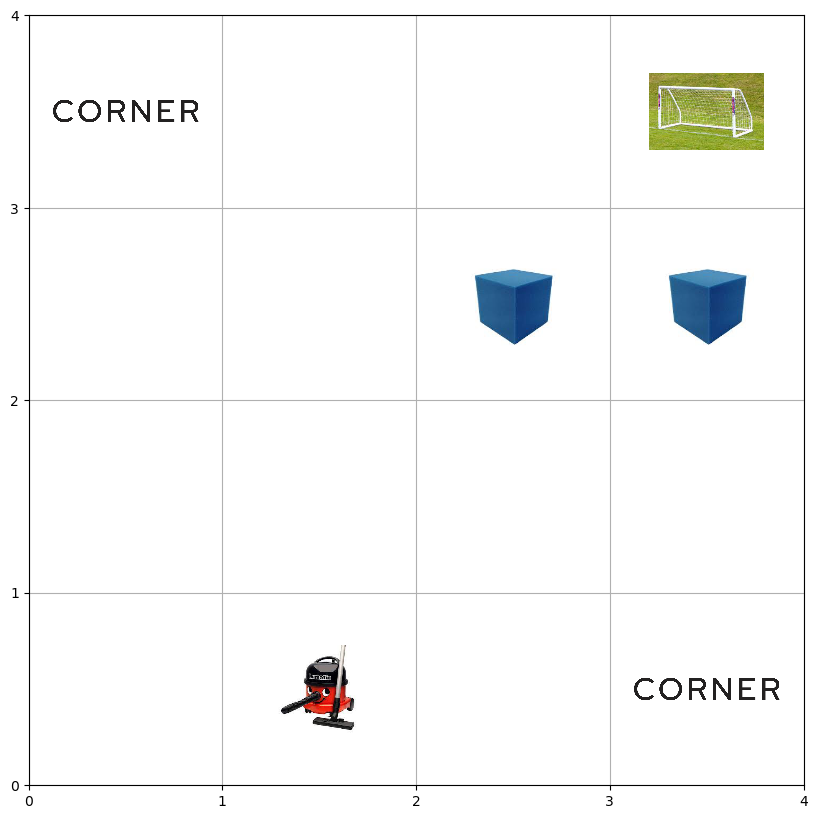

Action: 4 , Reward: 0 , Done: False


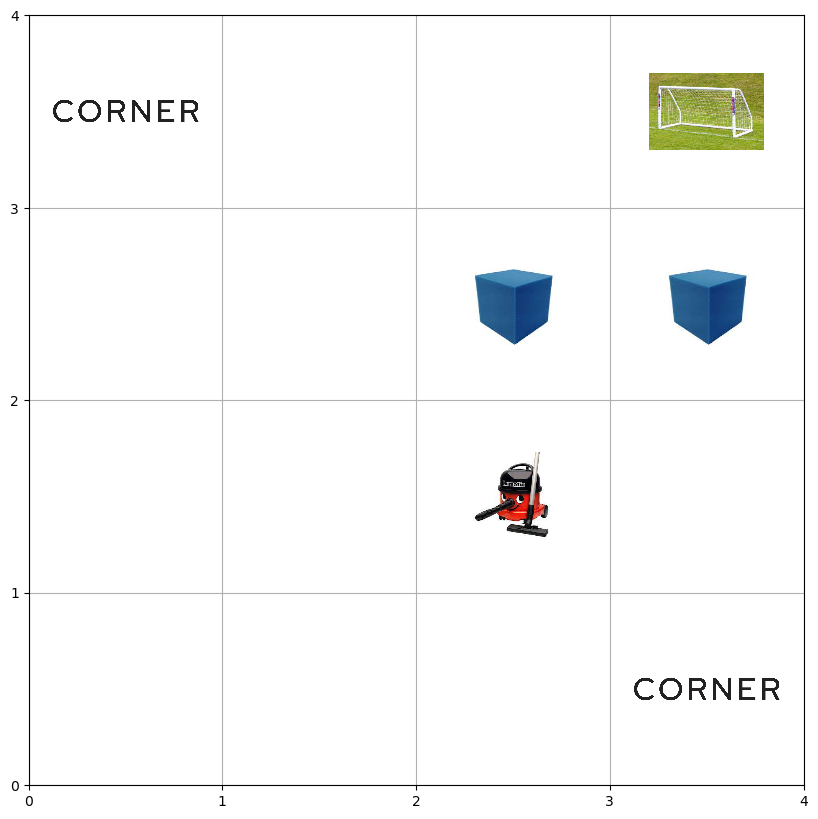

Action: 3 , Reward: 0 , Done: False


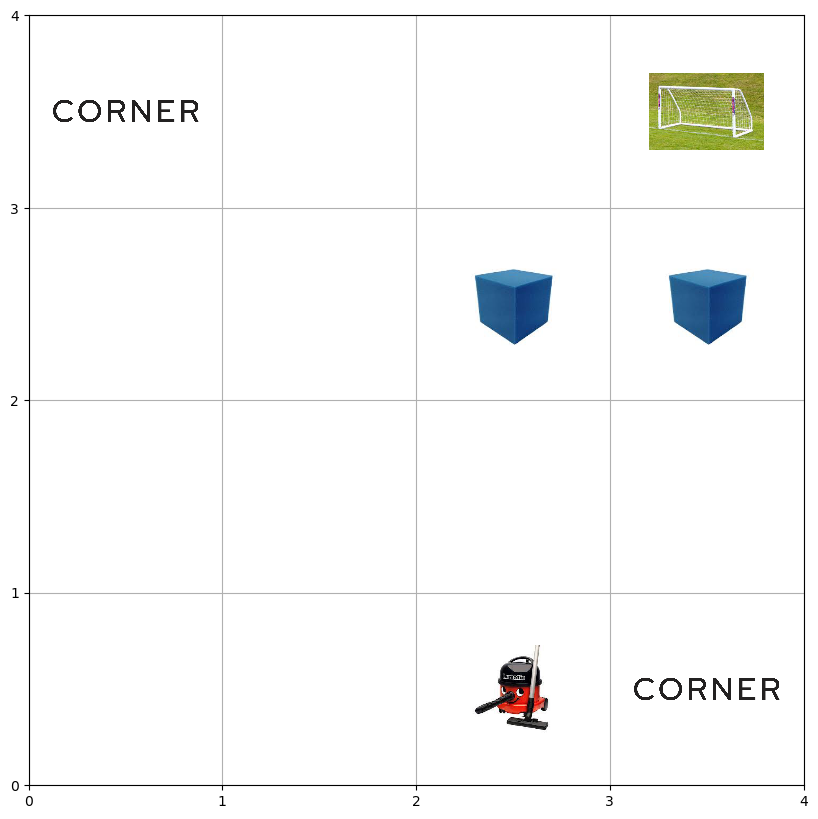

Action: 5 , Reward: 0 , Done: False


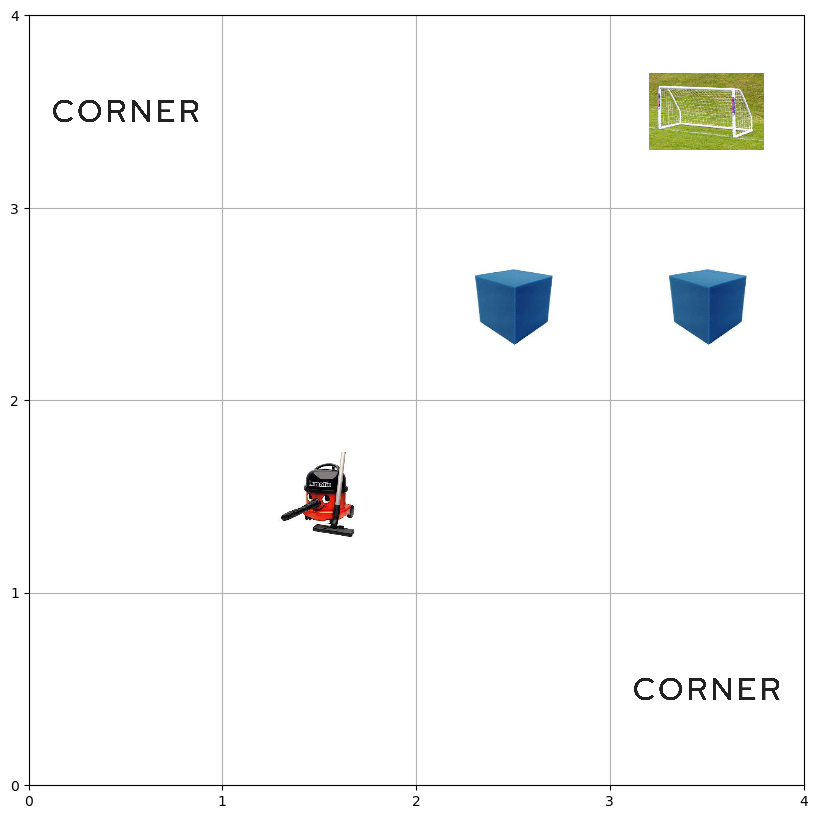

Action: 0 , Reward: 0 , Done: False


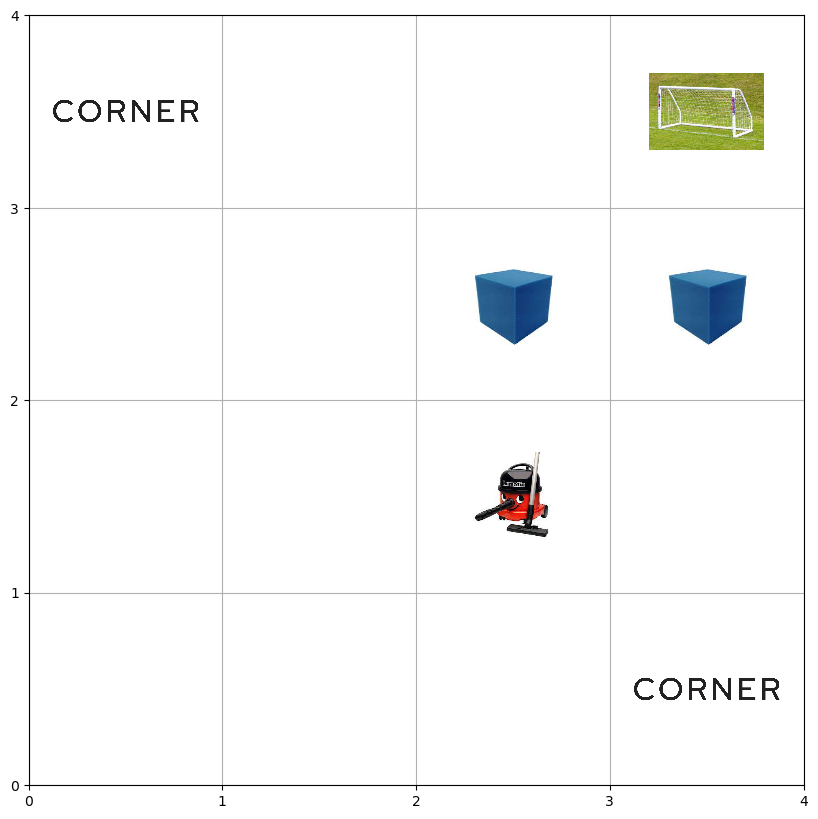

Action: 5 , Reward: 0 , Done: False


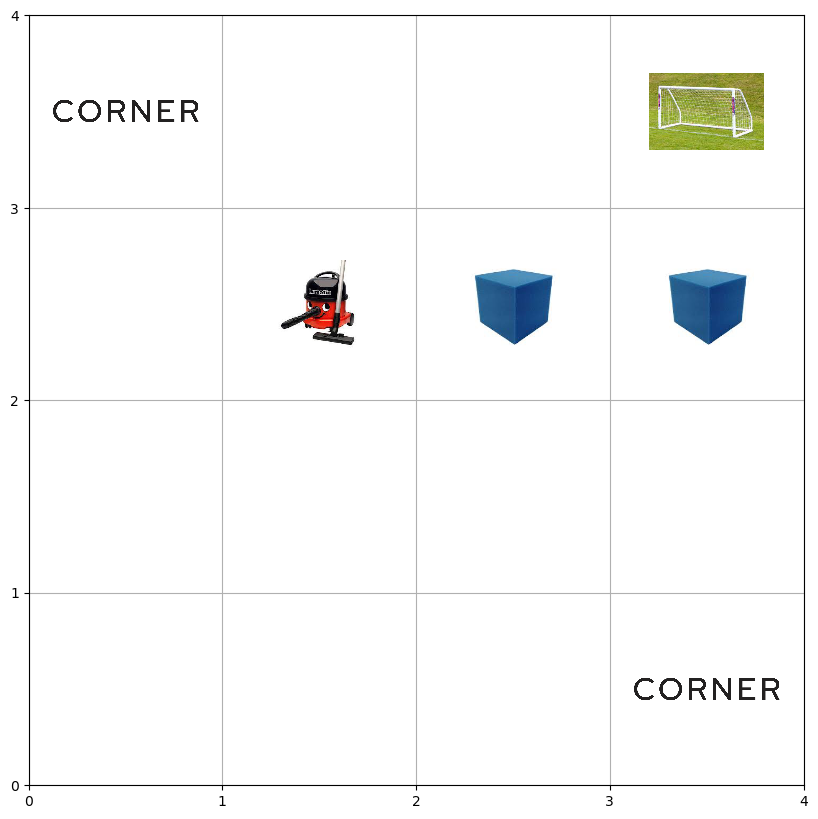

Action: 5 , Reward: 2 , Done: False


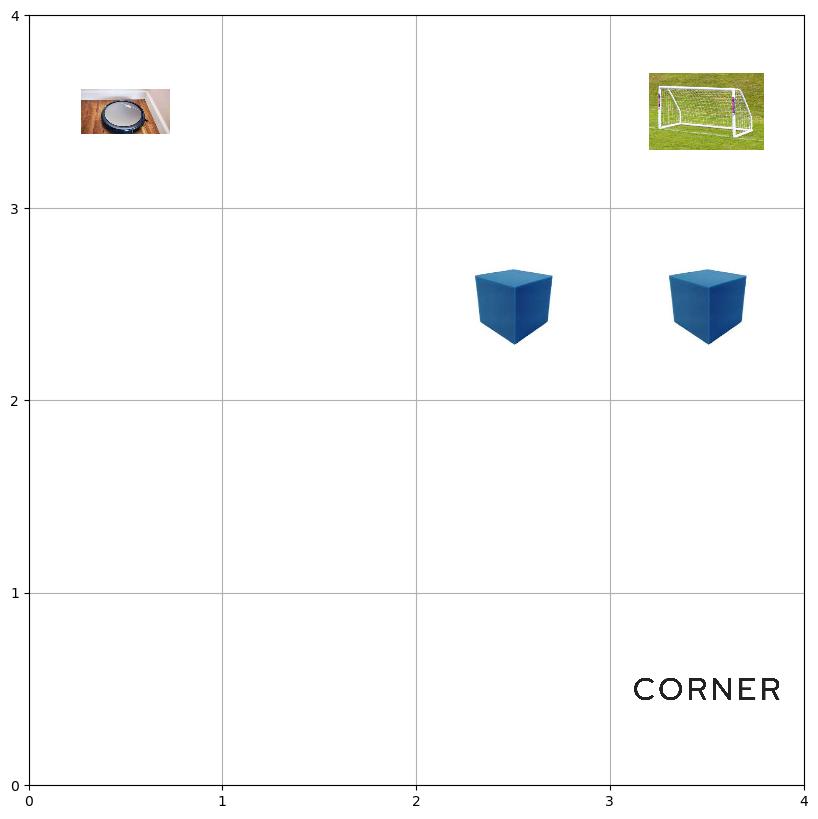

Action: 7 , Reward: 0 , Done: False


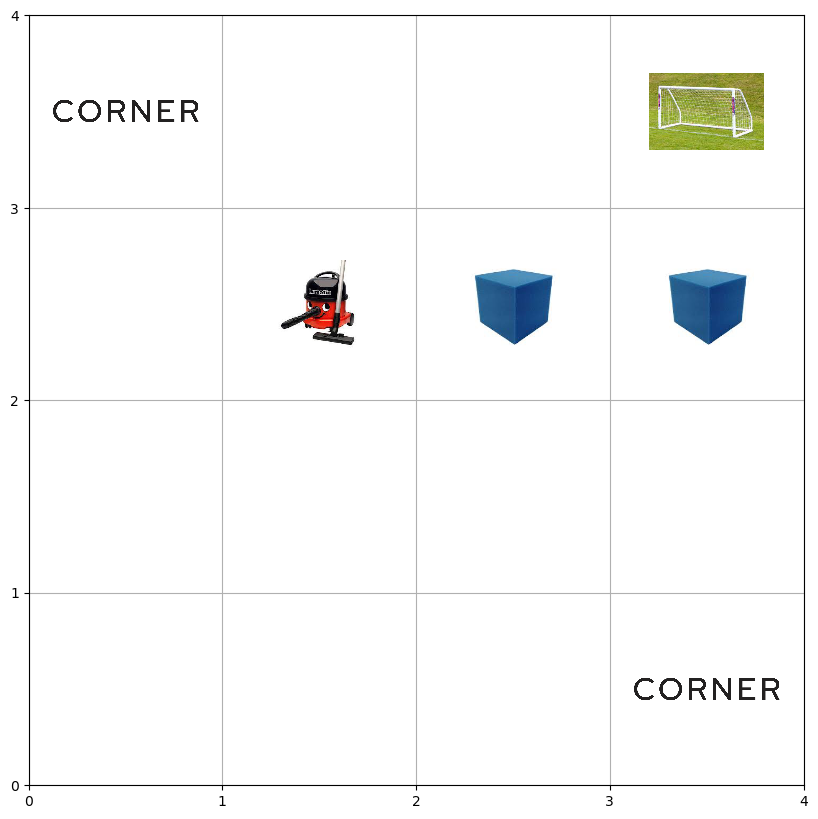

Action: 3 , Reward: 0 , Done: False


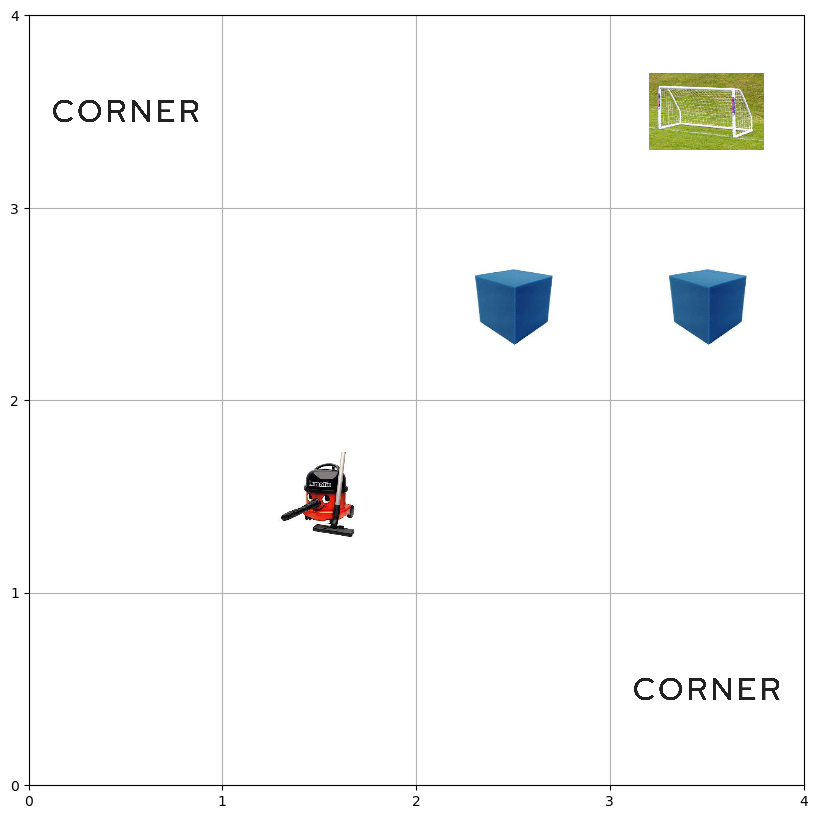

Action: 4 , Reward: -1 , Done: False


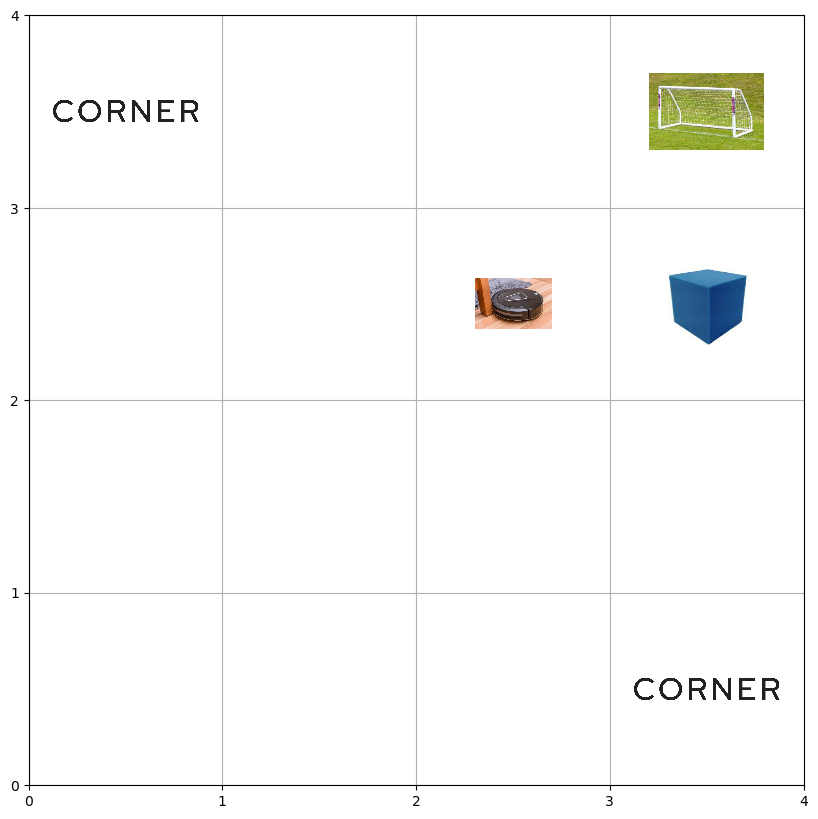

Action: 3 , Reward: 0 , Done: False


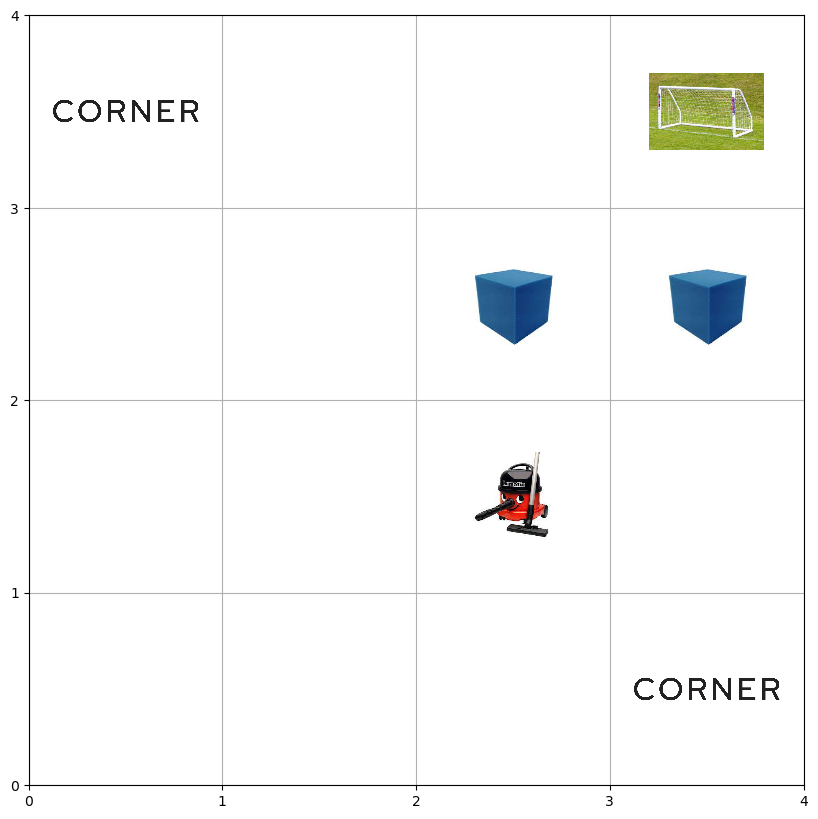

Action: 7 , Reward: 2 , Done: False


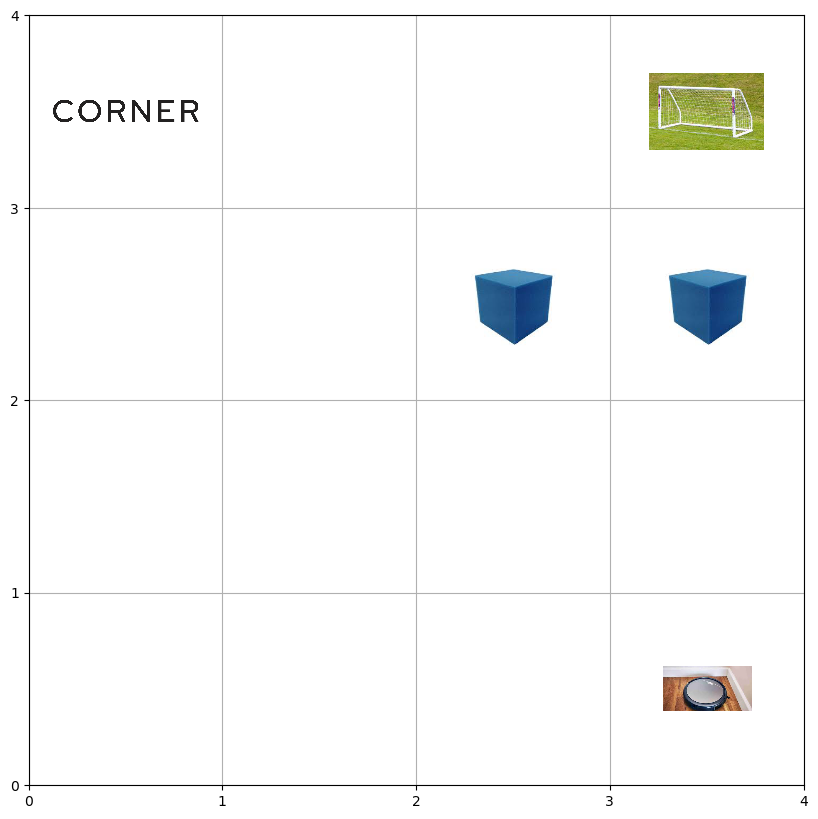

Action: 5 , Reward: 0 , Done: False


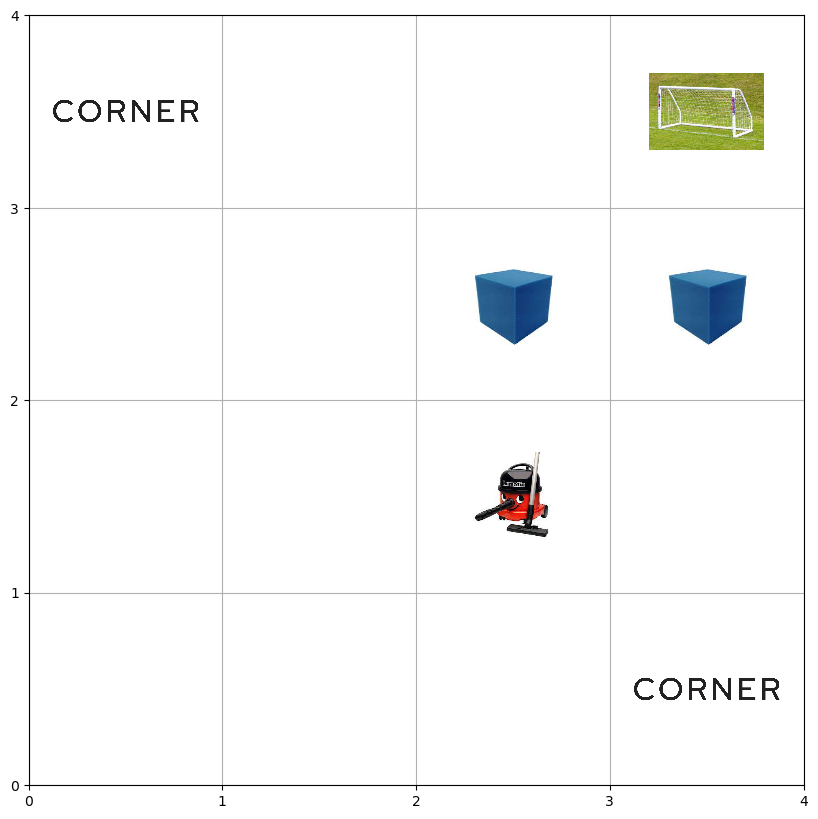

Action: 1 , Reward: 0 , Done: False


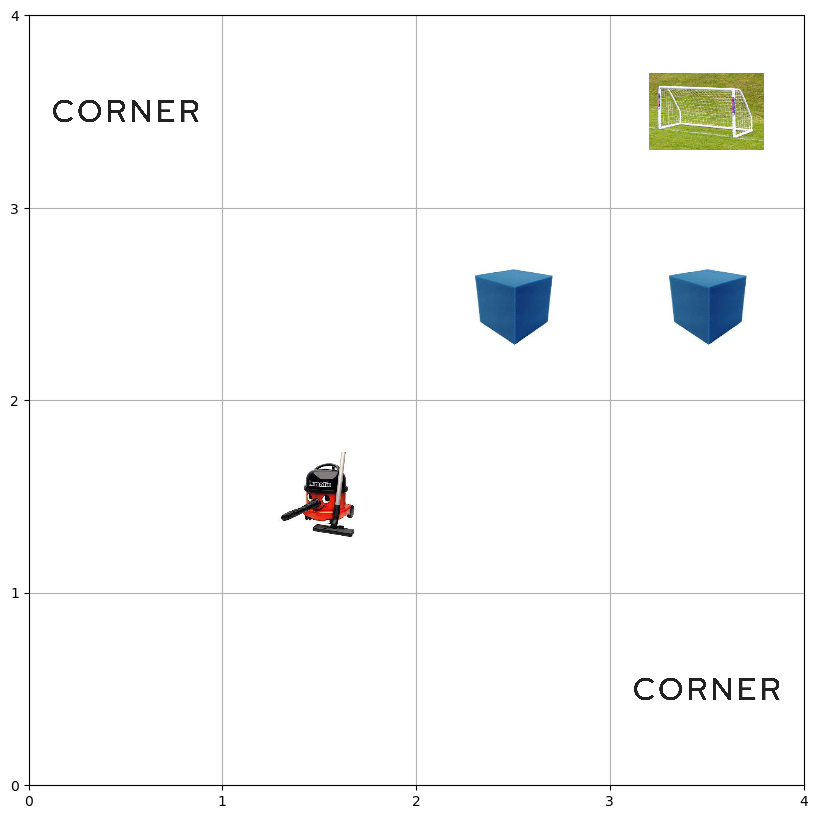

Action: 5 , Reward: 0 , Done: False


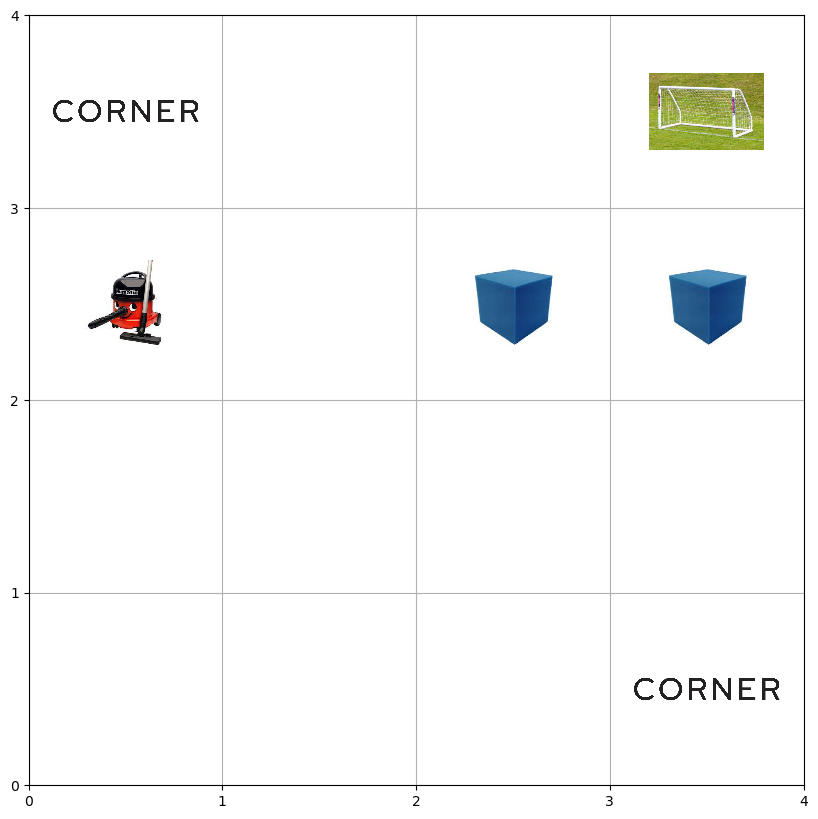

Action: 1 , Reward: 0 , Done: False


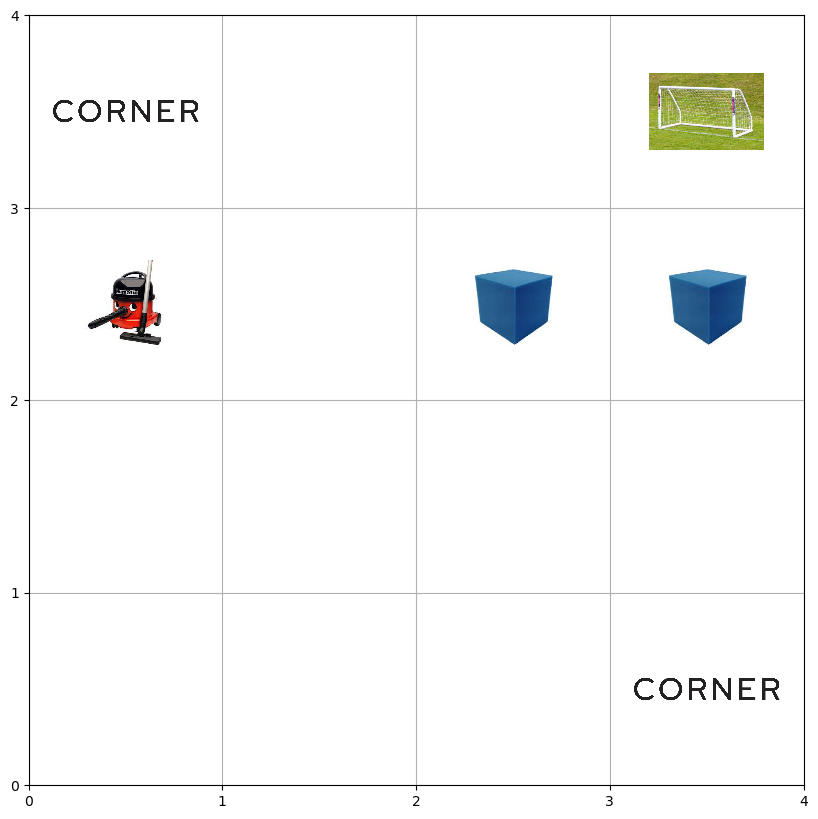

Action: 5 , Reward: 2 , Done: False


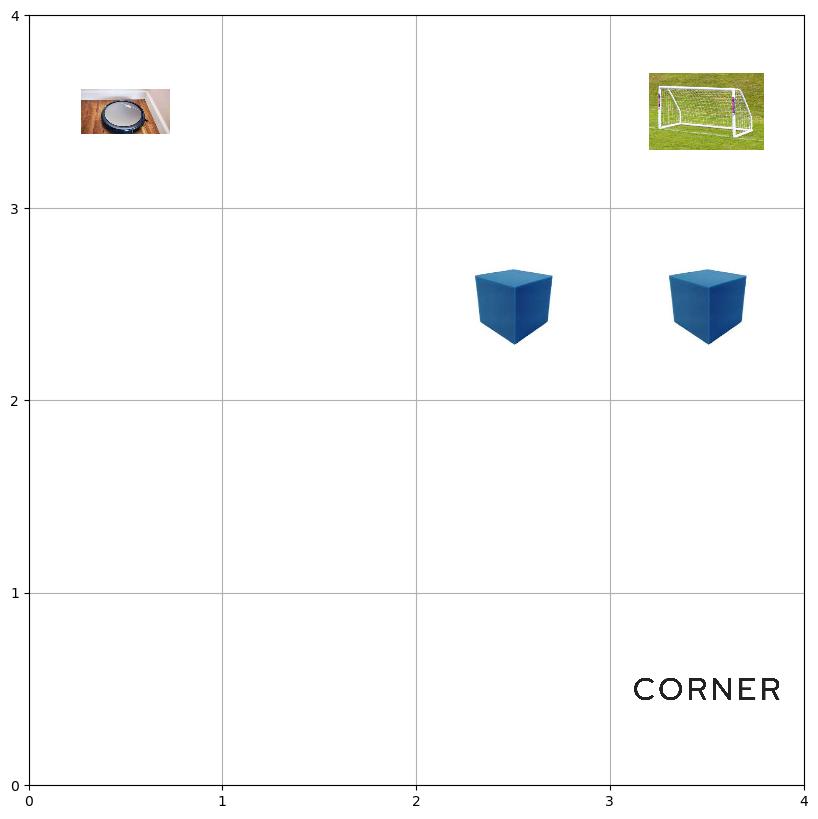

Action: 0 , Reward: 0 , Done: False


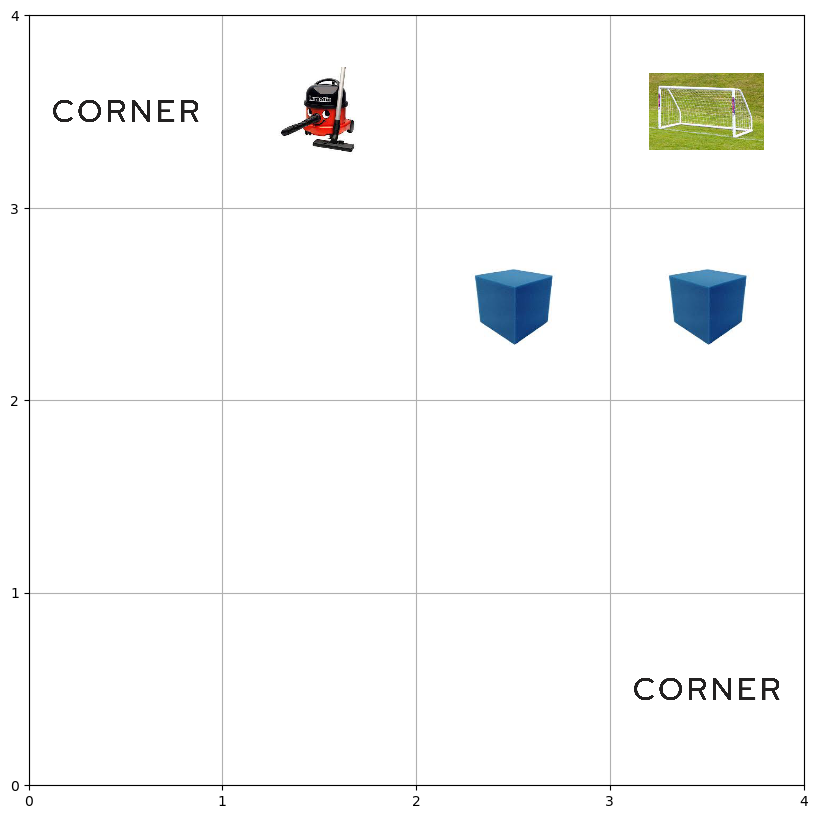

Action: 7 , Reward: -1 , Done: False


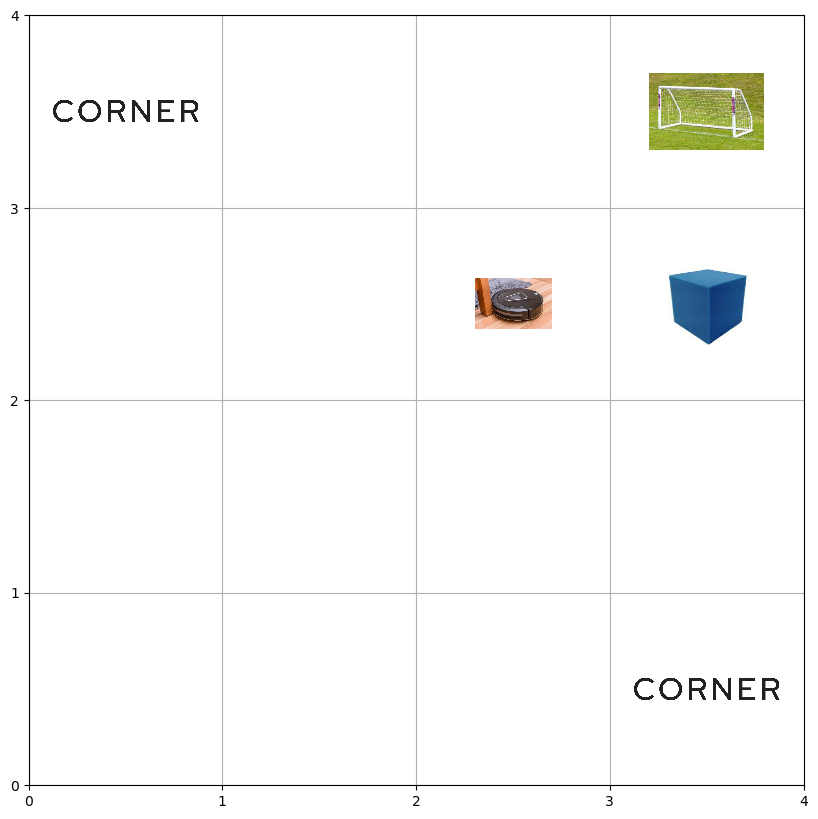

Action: 2 , Reward: 0 , Done: False


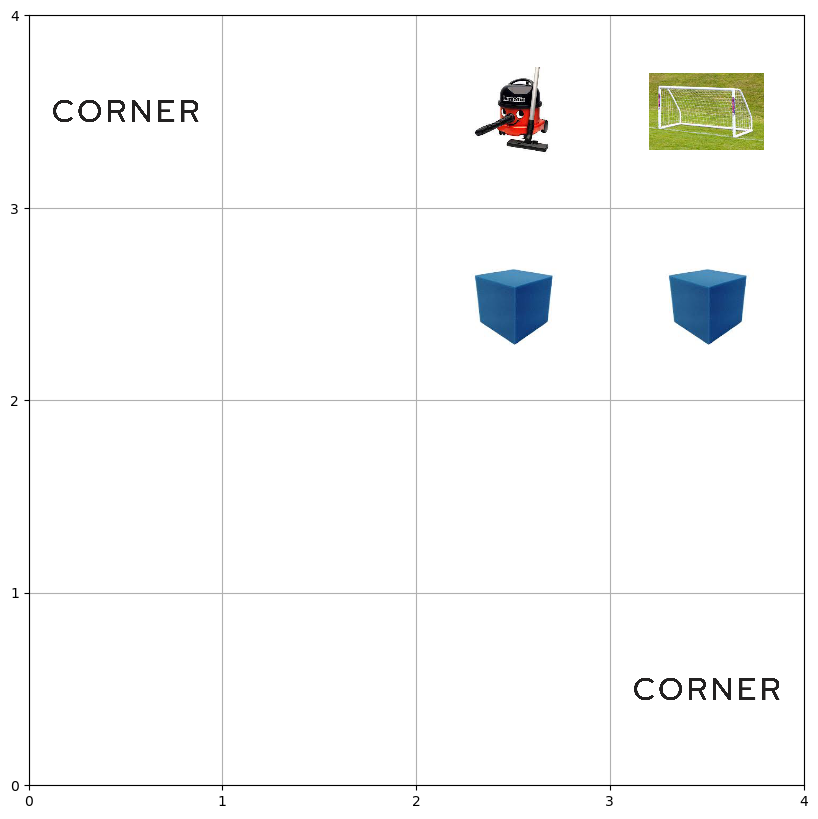

Action: 5 , Reward: 0 , Done: False


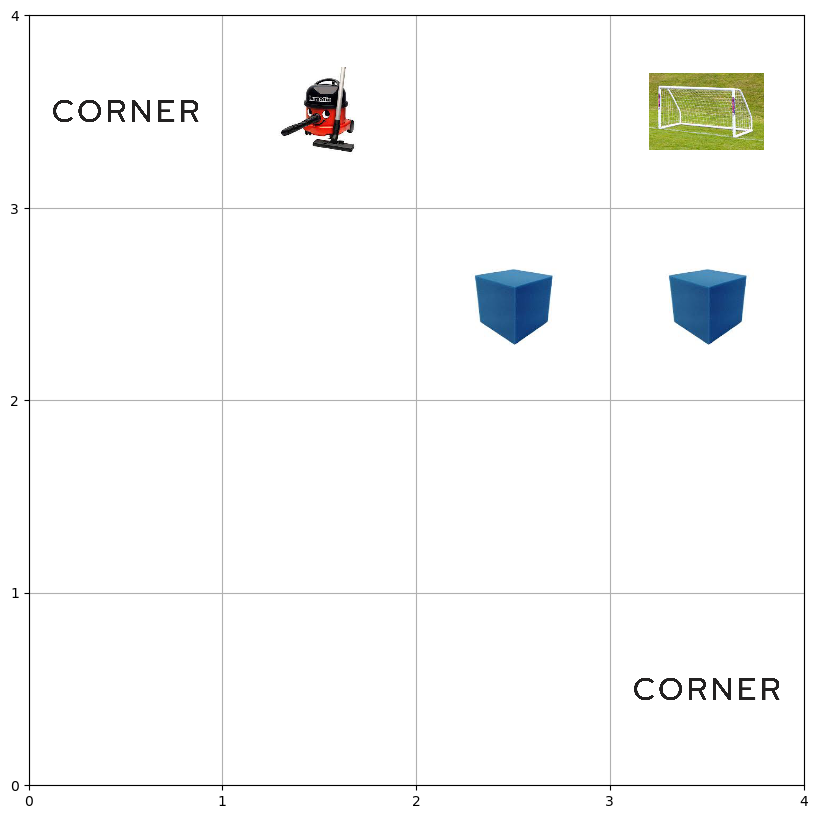

Action: 2 , Reward: 0 , Done: False


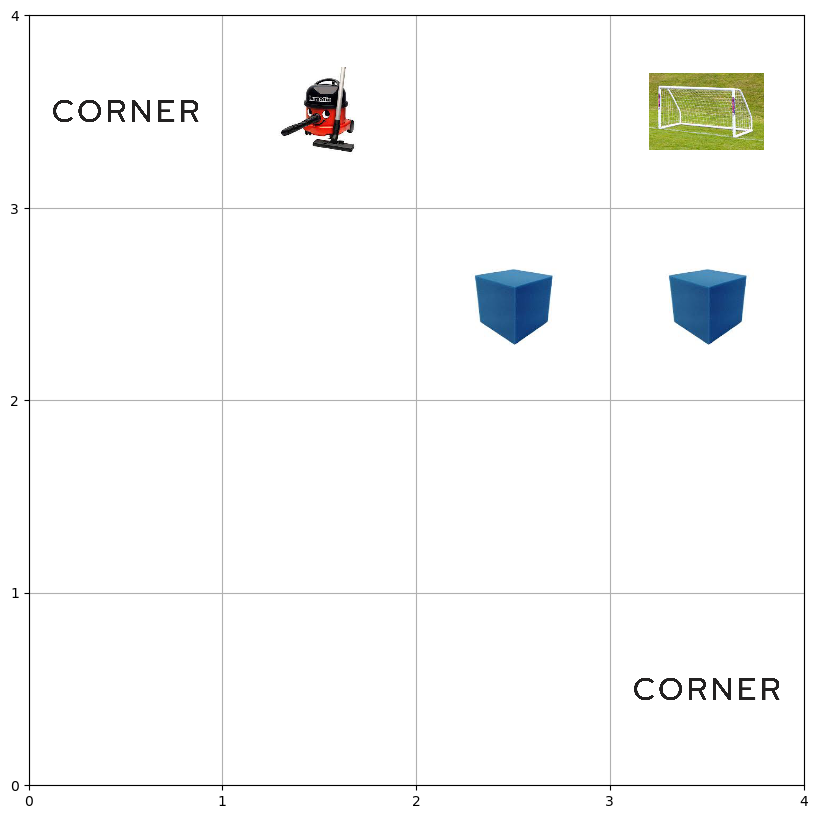

Action: 6 , Reward: 0 , Done: False


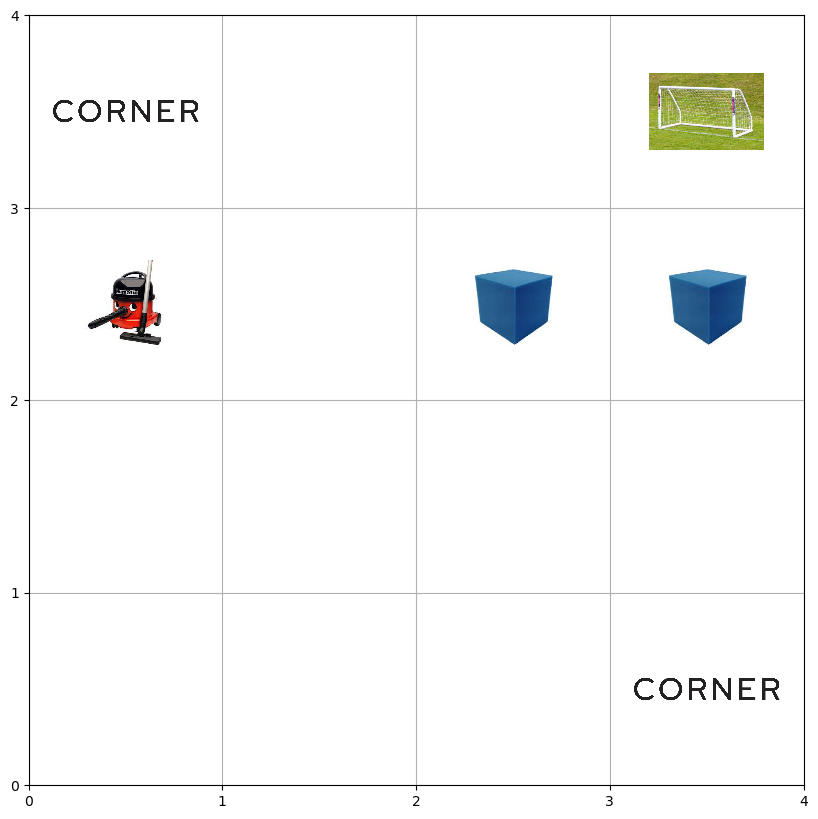

Action: 7 , Reward: 0 , Done: False


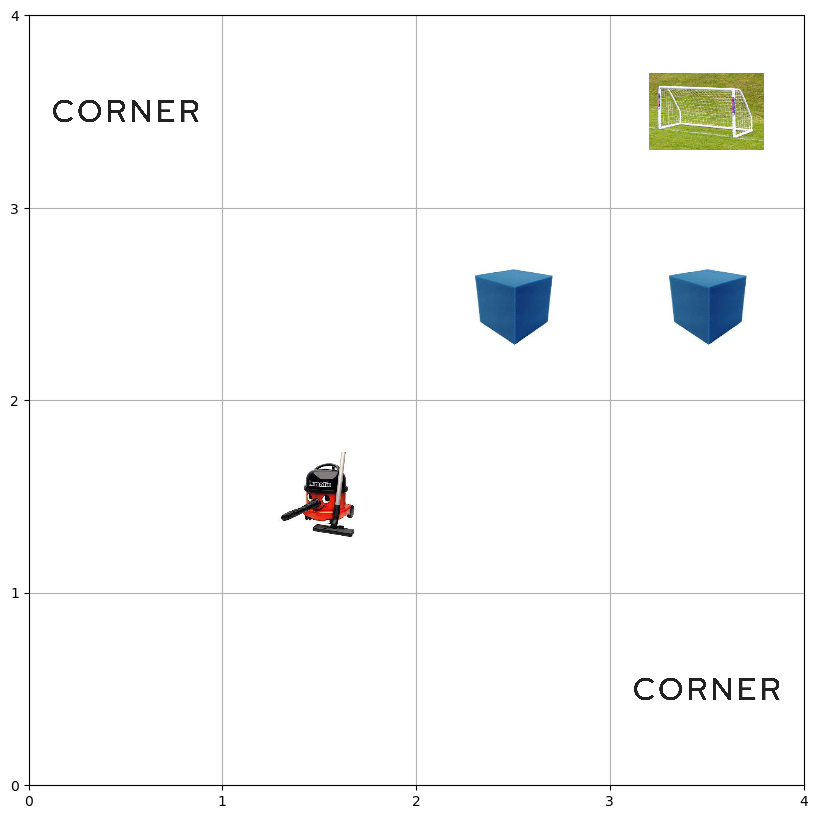

Action: 3 , Reward: 0 , Done: False


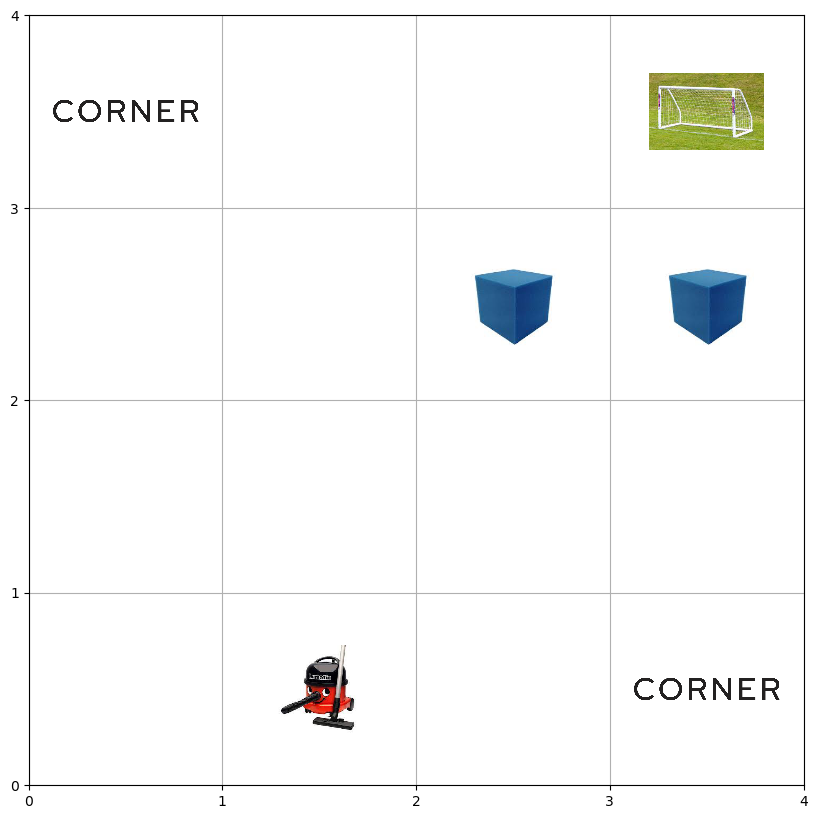

Action: 5 , Reward: 0 , Done: False


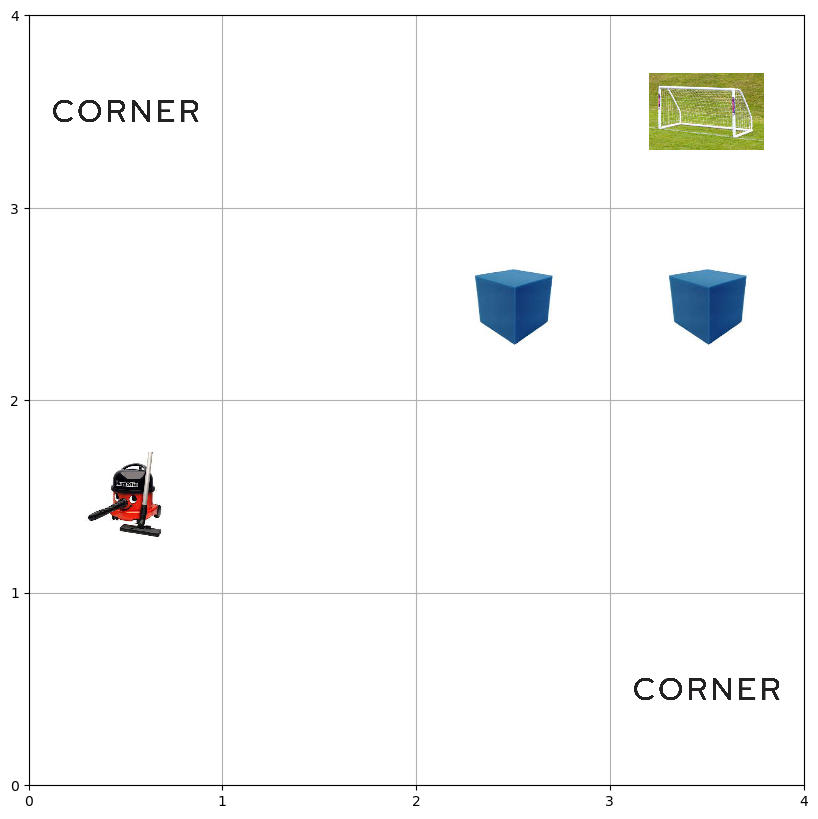

Action: 5 , Reward: 0 , Done: False


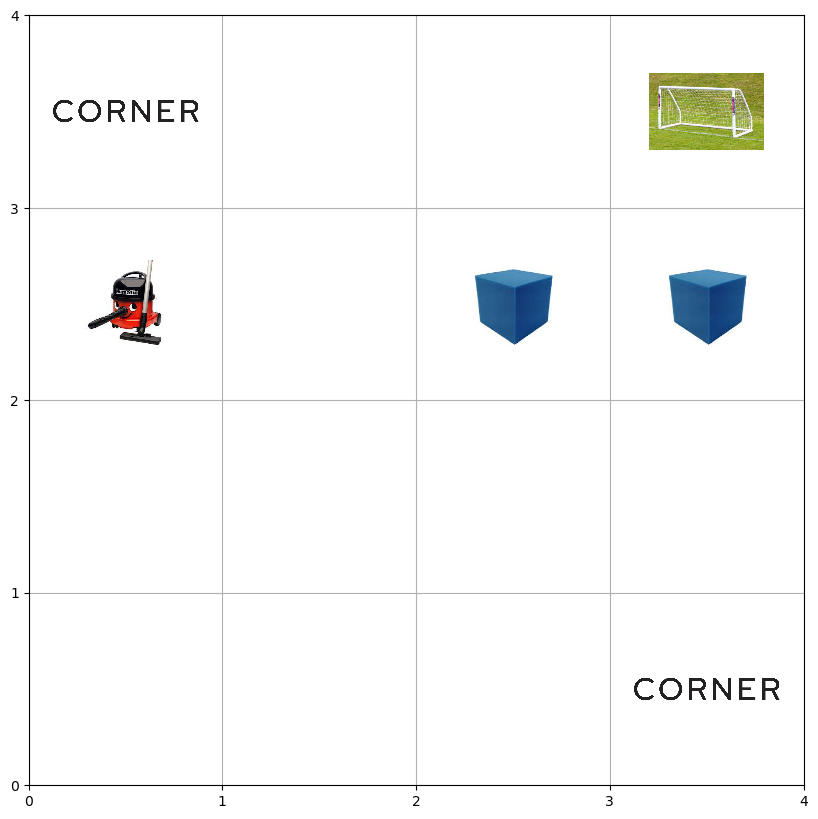

Action: 2 , Reward: 2 , Done: False


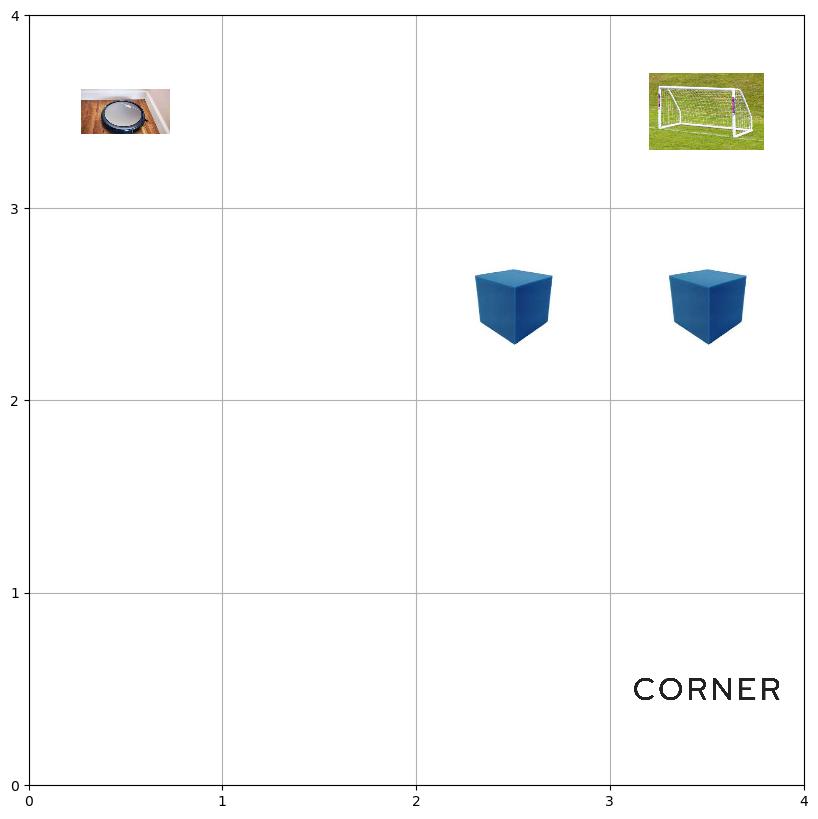

Action: 6 , Reward: 0 , Done: False


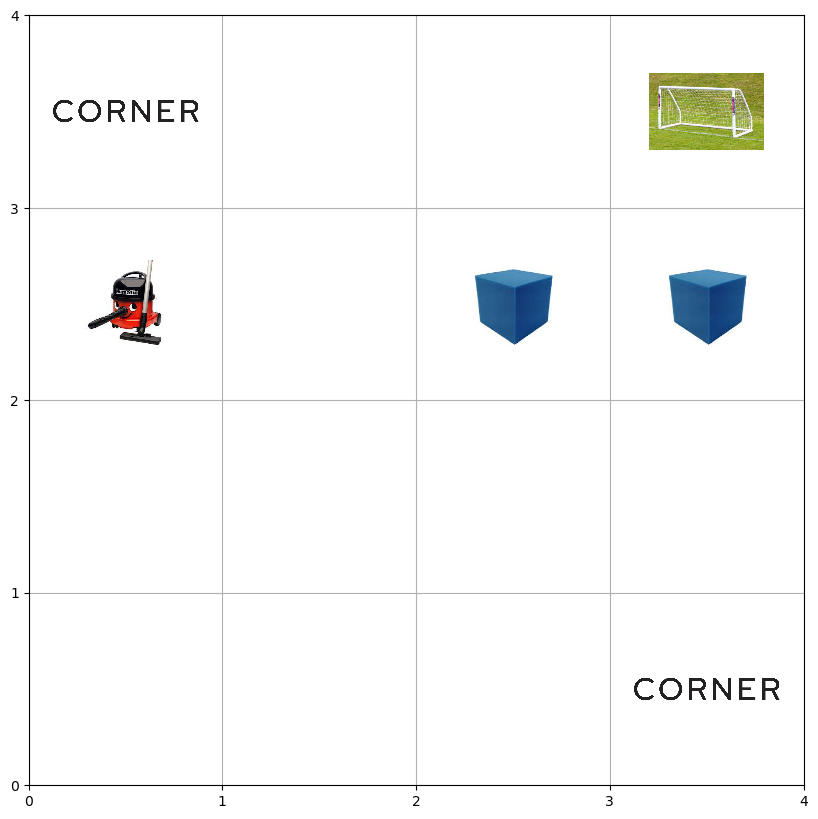

Action: 0 , Reward: 0 , Done: False


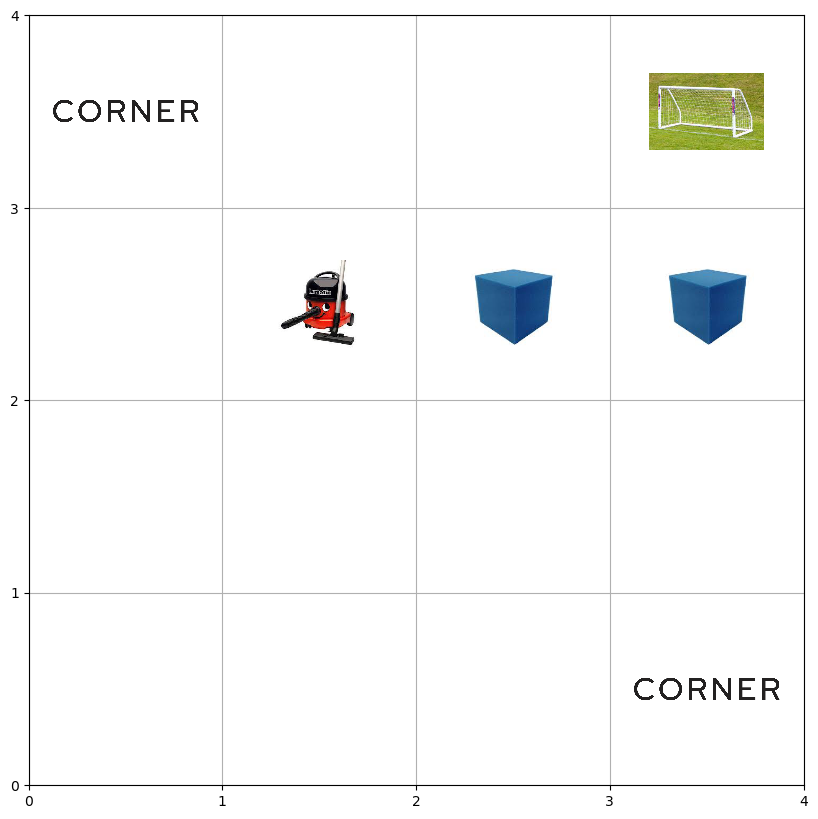

Action: 0 , Reward: -1 , Done: False


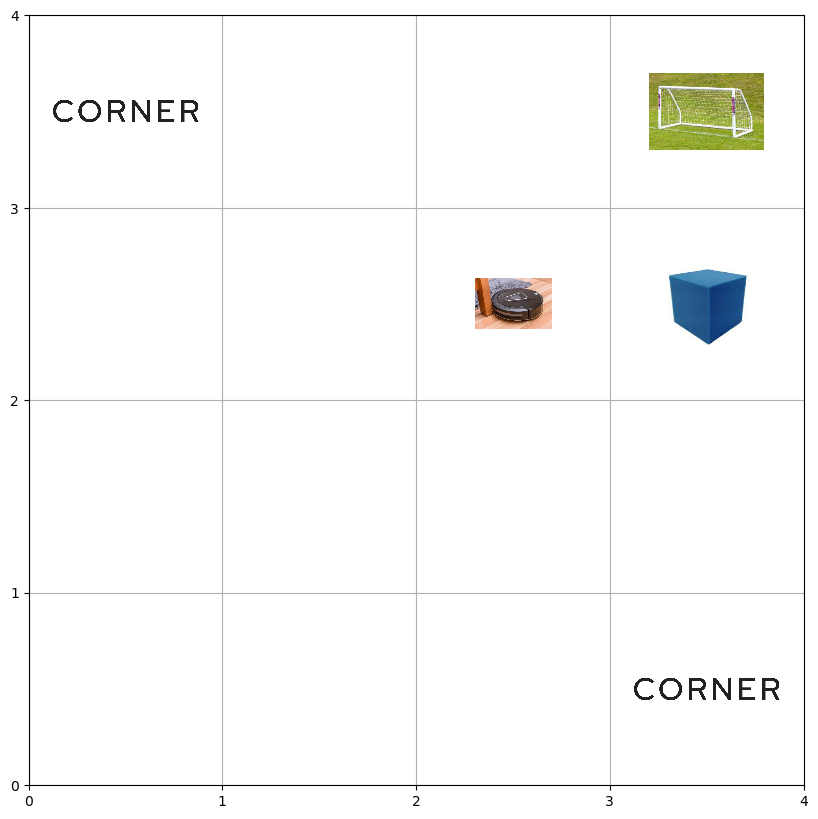

Action: 5 , Reward: 0 , Done: False


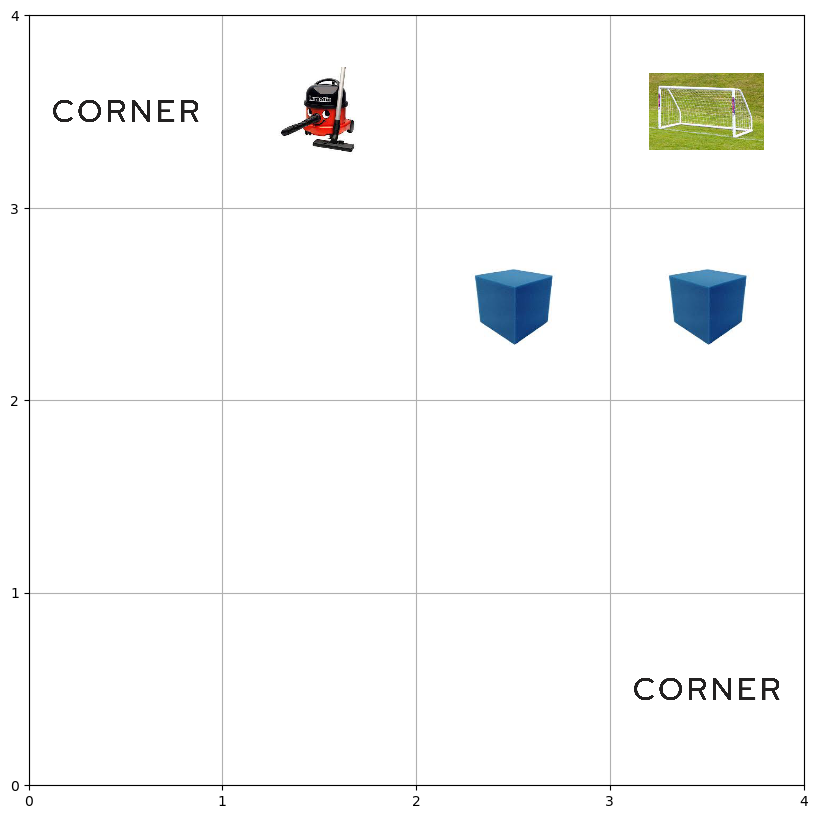

Action: 4 , Reward: 0 , Done: False


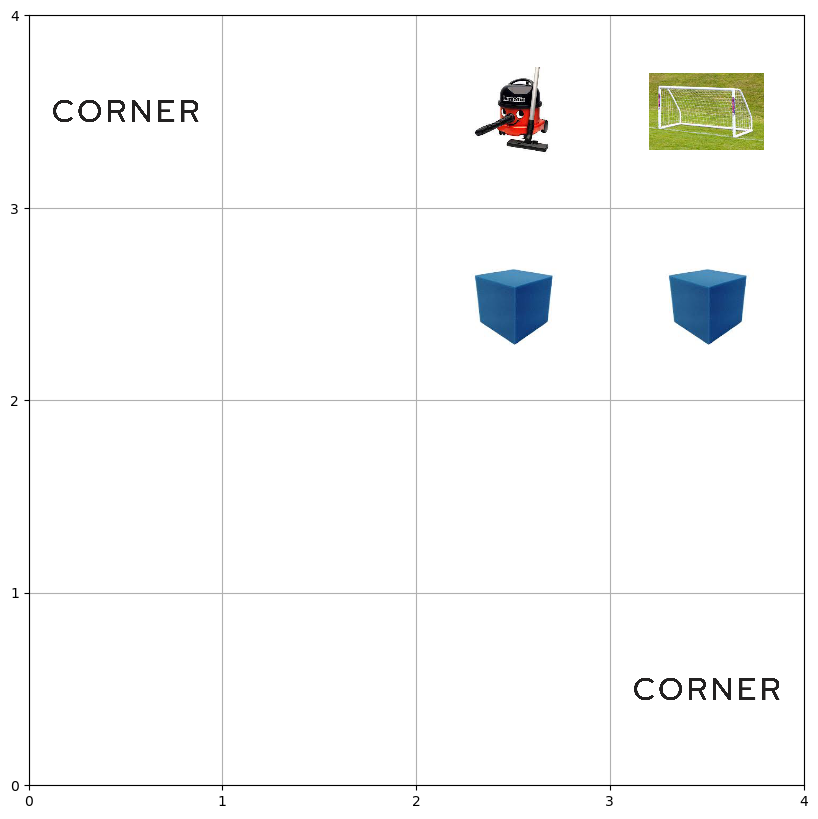

Action: 5 , Reward: 0 , Done: False


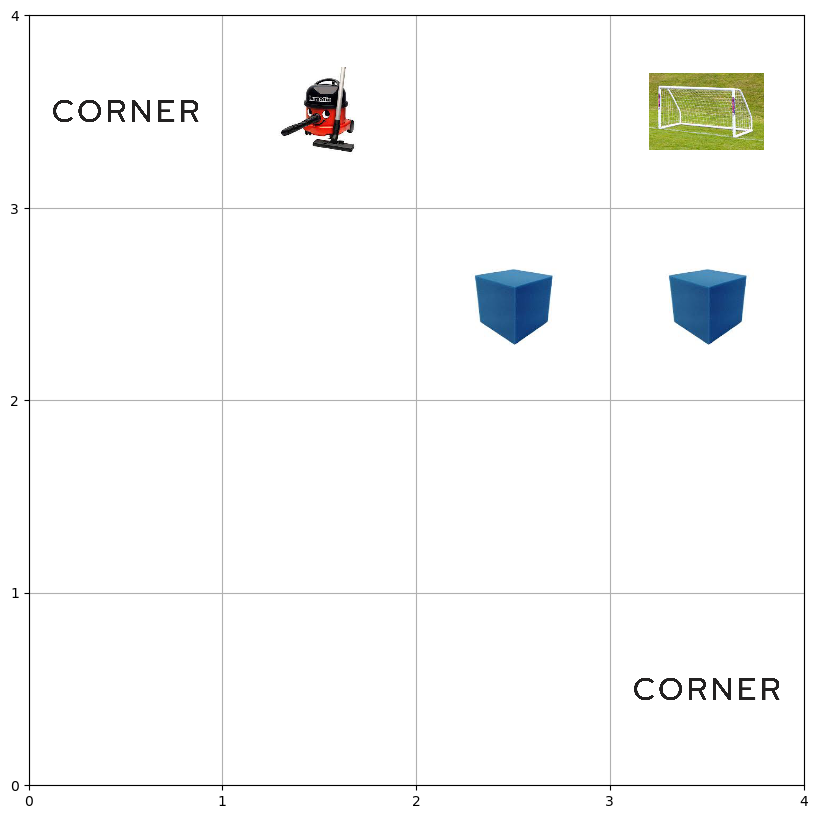

Action: 0 , Reward: 0 , Done: False


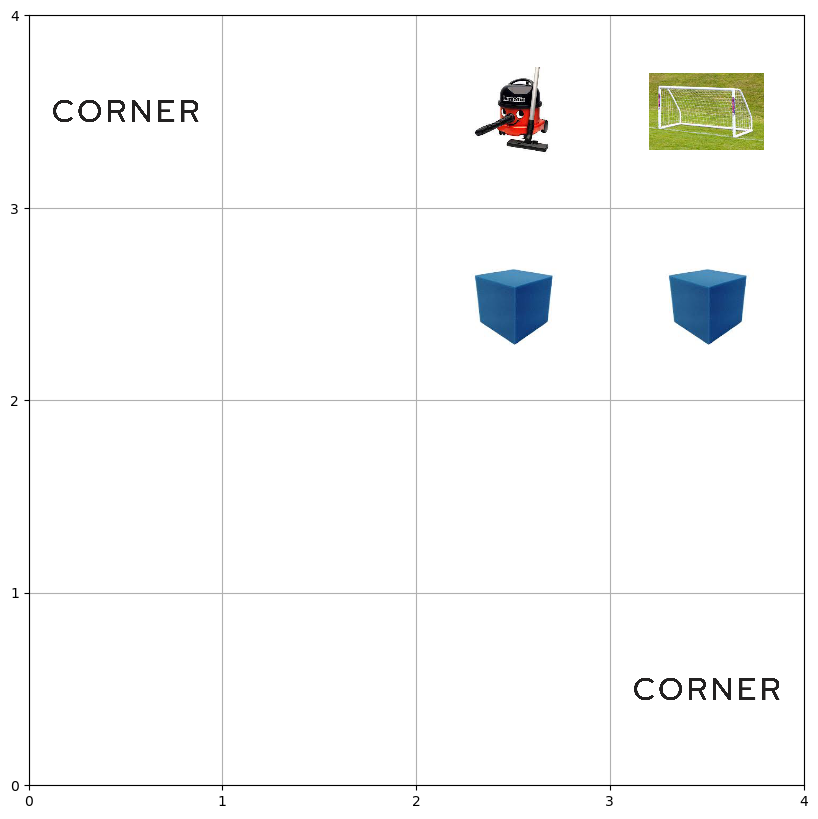

Action: 2 , Reward: 0 , Done: False


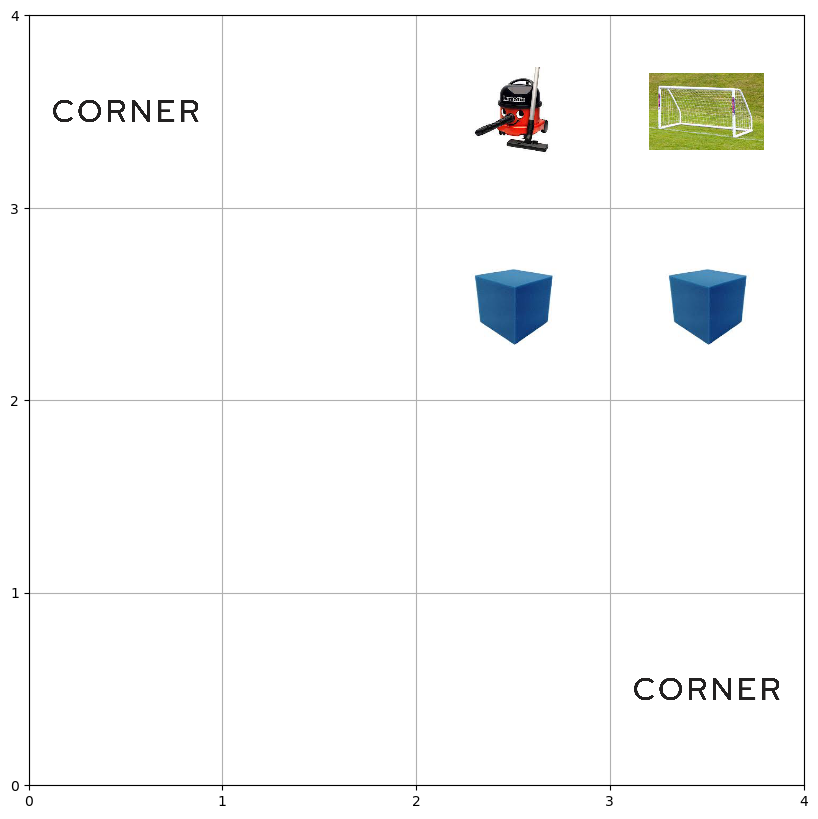

Action: 6 , Reward: 0 , Done: False


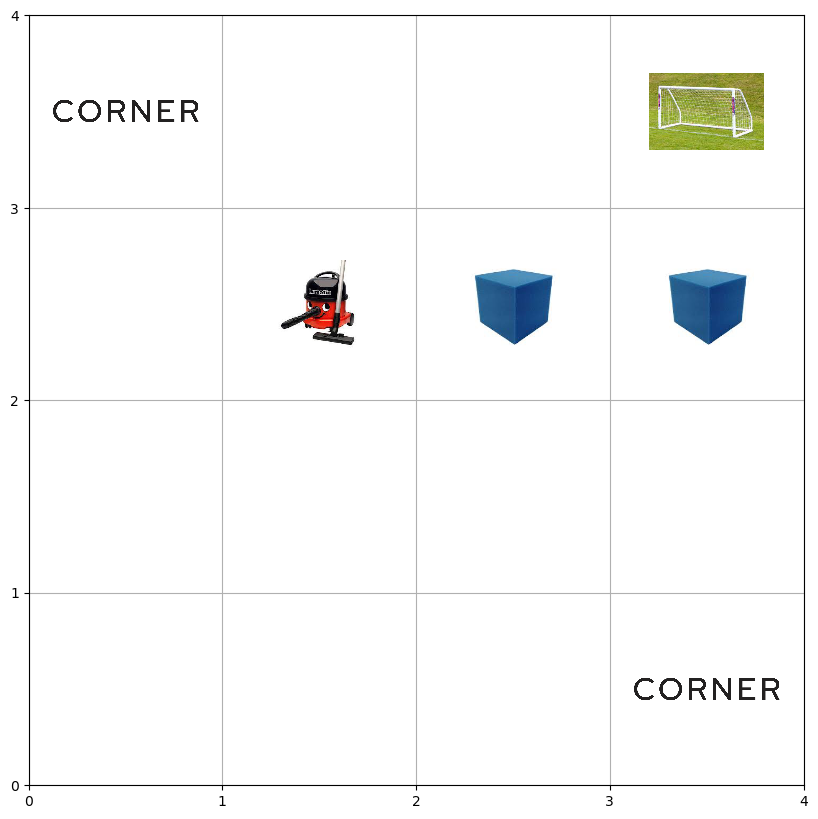

Action: 3 , Reward: 0 , Done: False


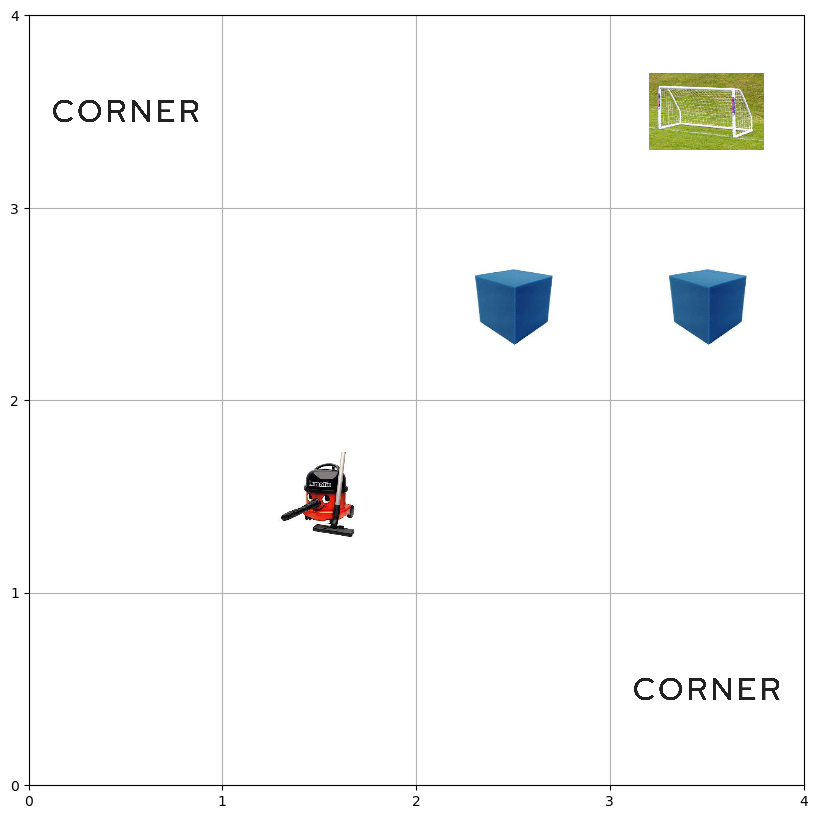

Action: 4 , Reward: -1 , Done: False


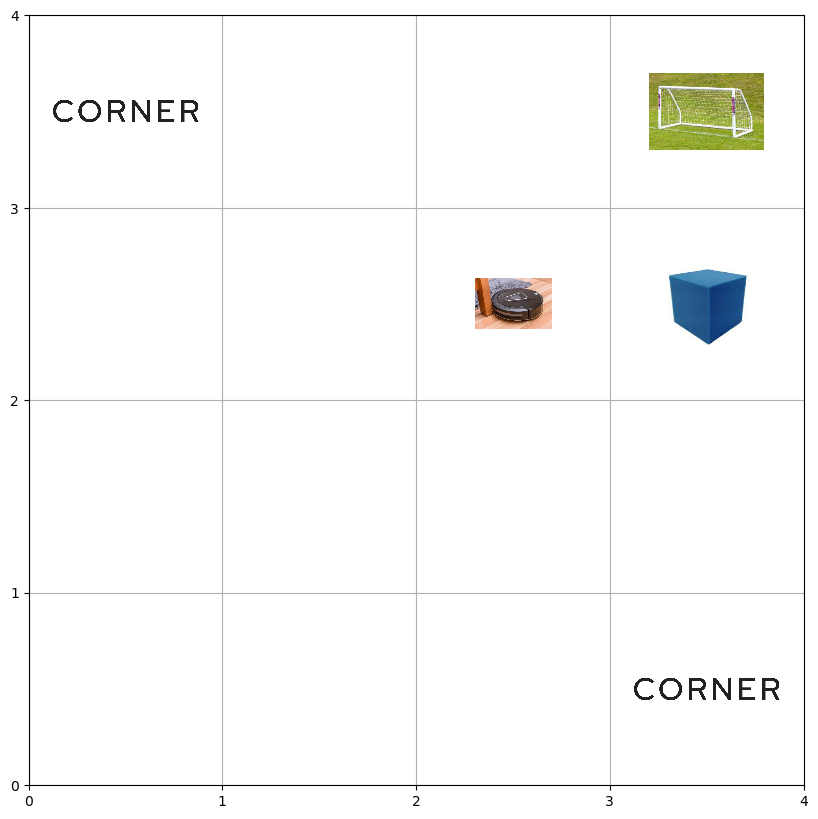

Action: 3 , Reward: 0 , Done: False


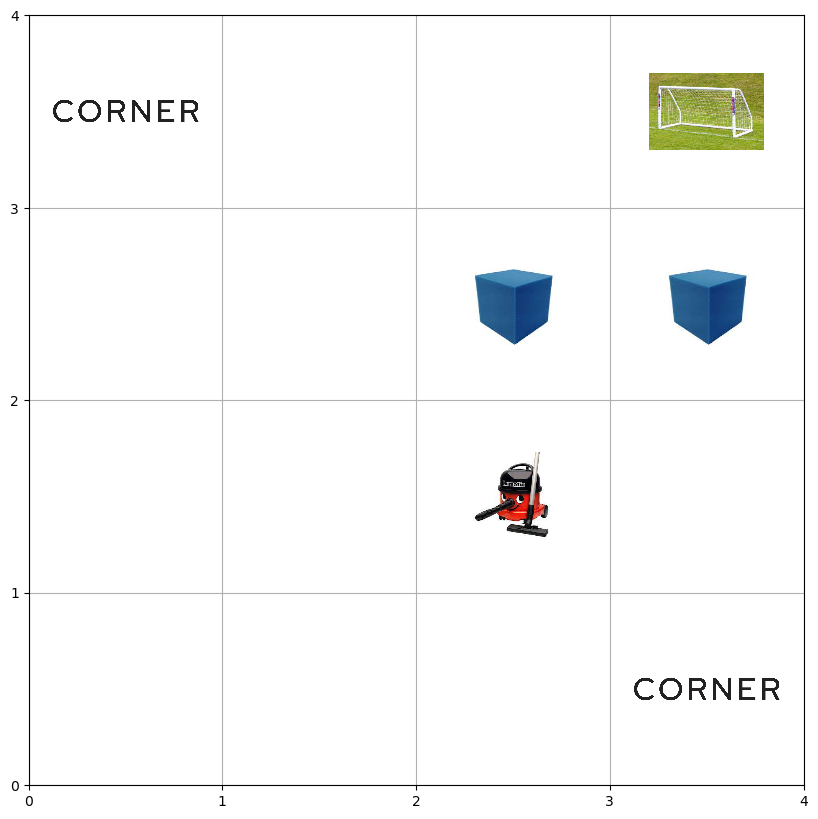

Action: 4 , Reward: -1 , Done: False


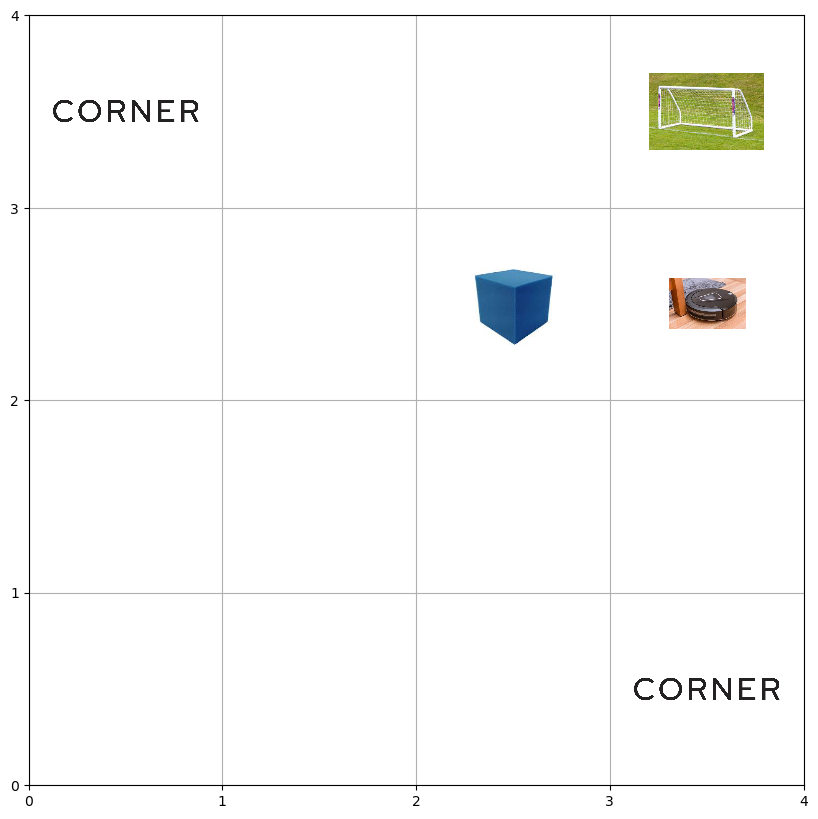

Action: 2 , Reward: 5 , Done: False


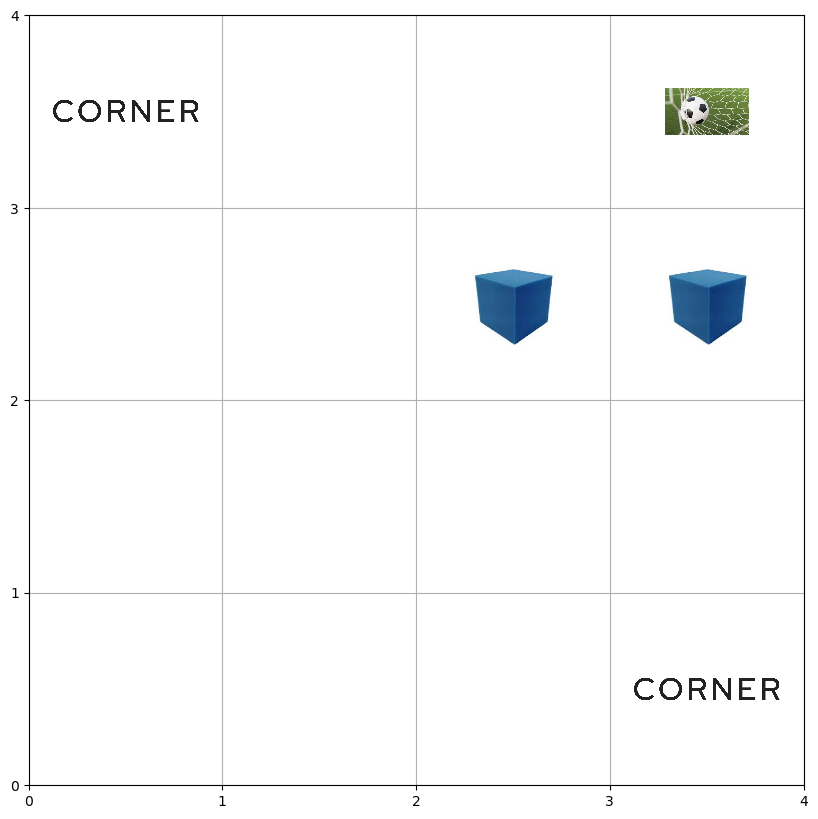

Action: 2 , Reward: 5 , Done: False


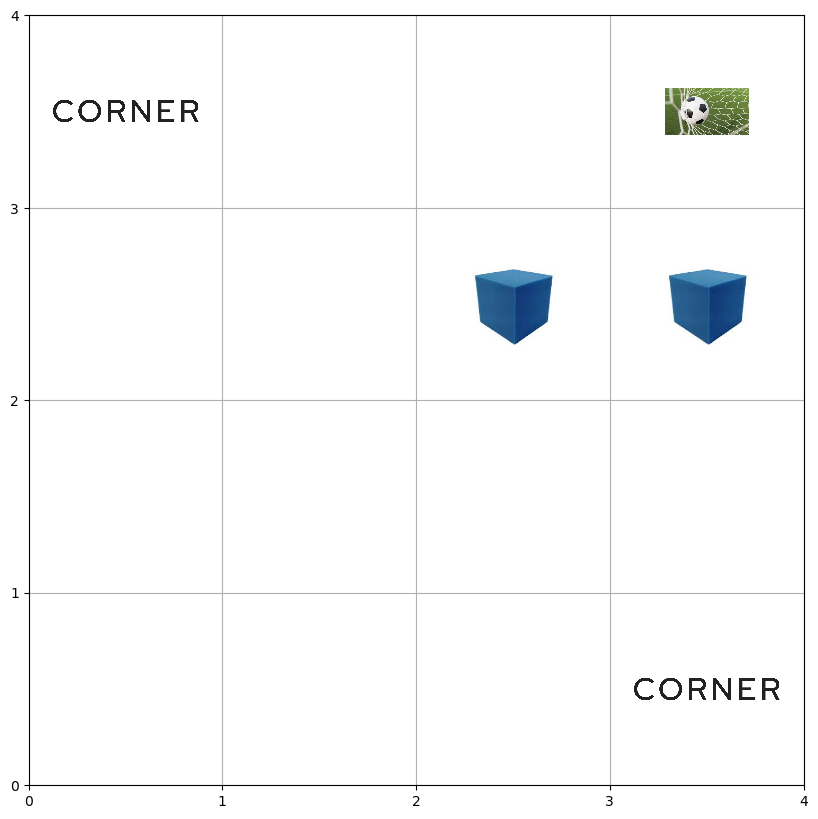

Action: 3 , Reward: -1 , Done: False


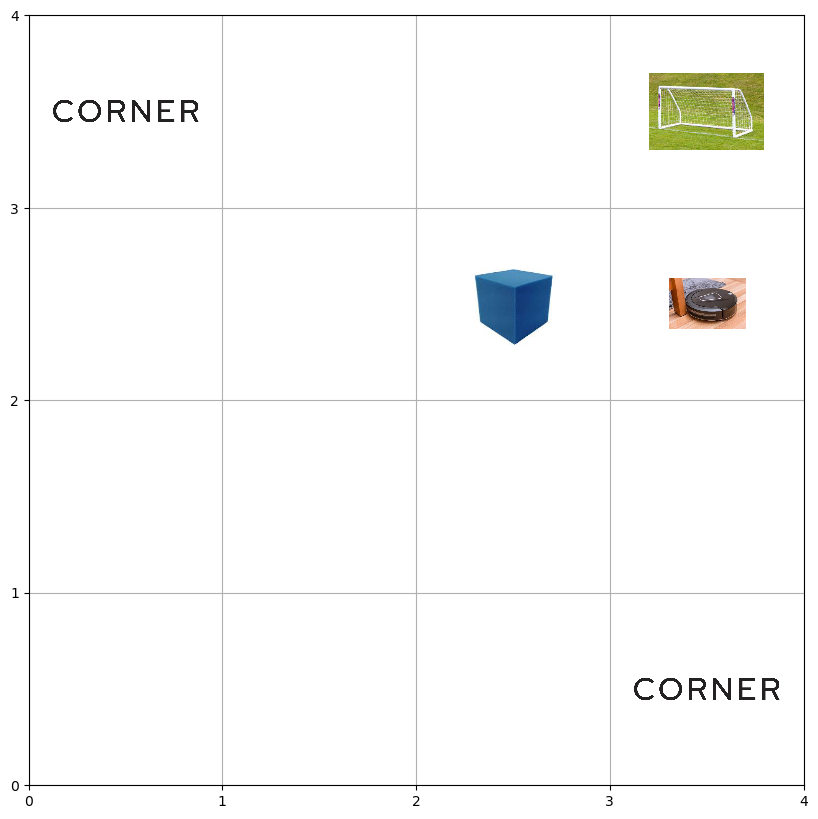

Action: 6 , Reward: 0 , Done: False


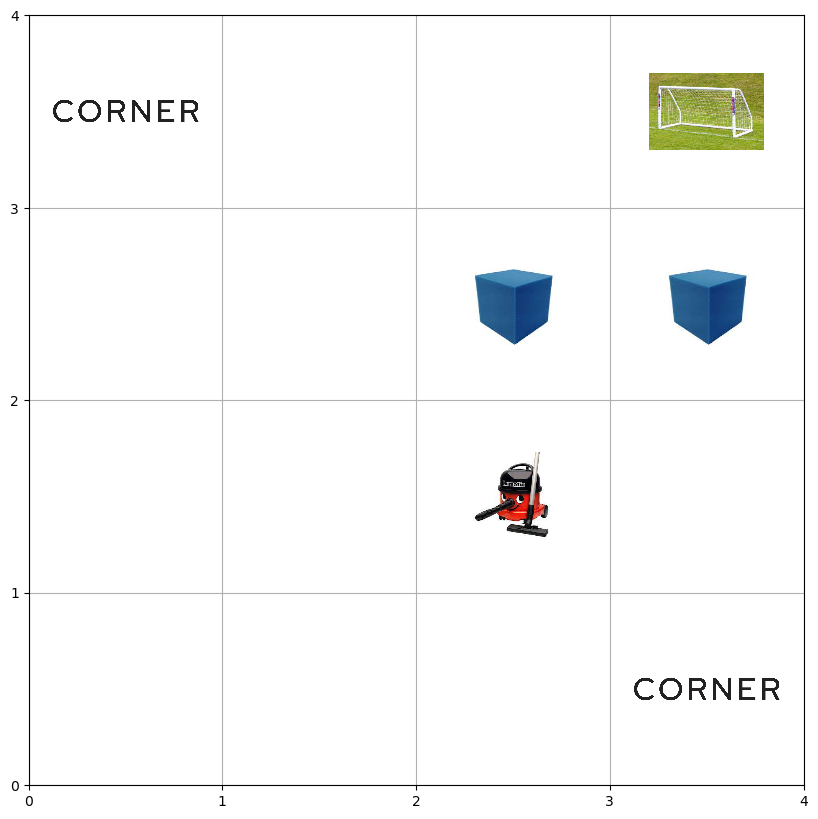

Action: 3 , Reward: 0 , Done: False


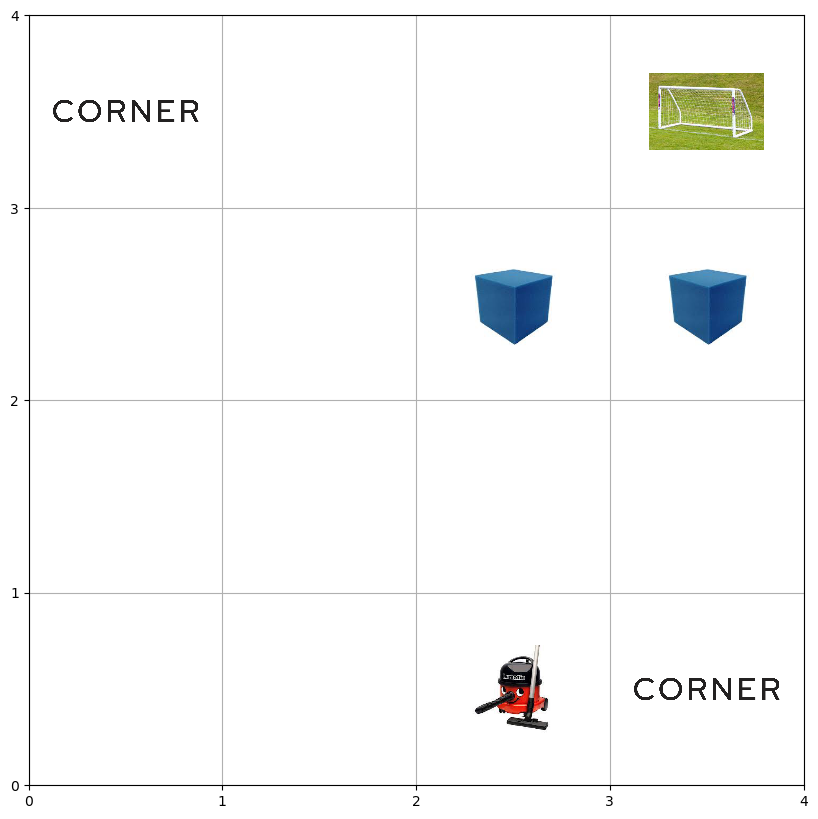

Action: 7 , Reward: 2 , Done: False


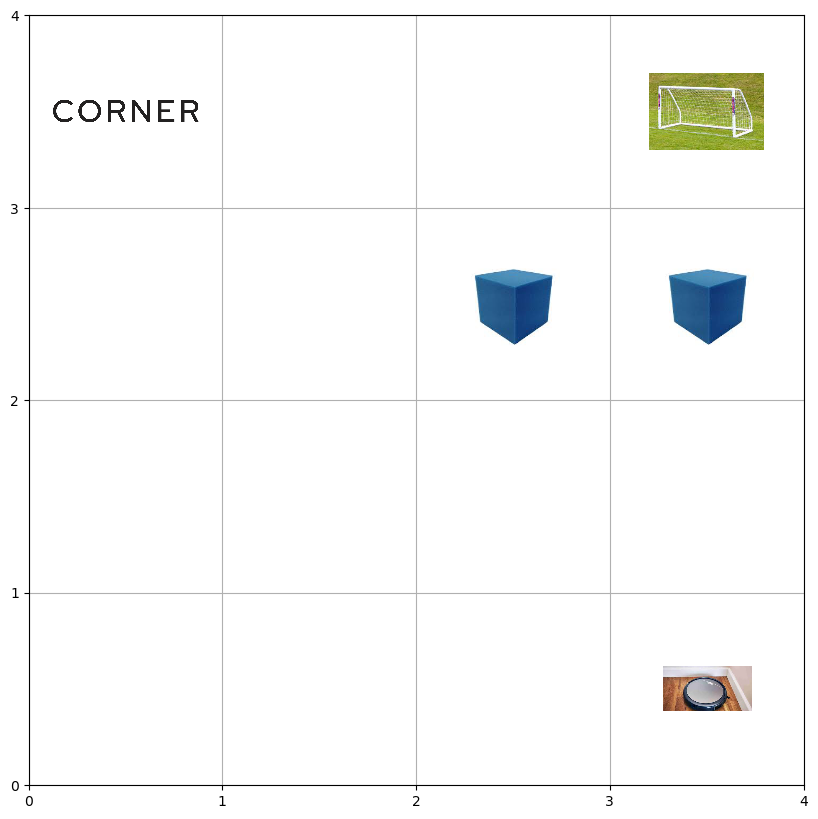

Action: 6 , Reward: 0 , Done: True


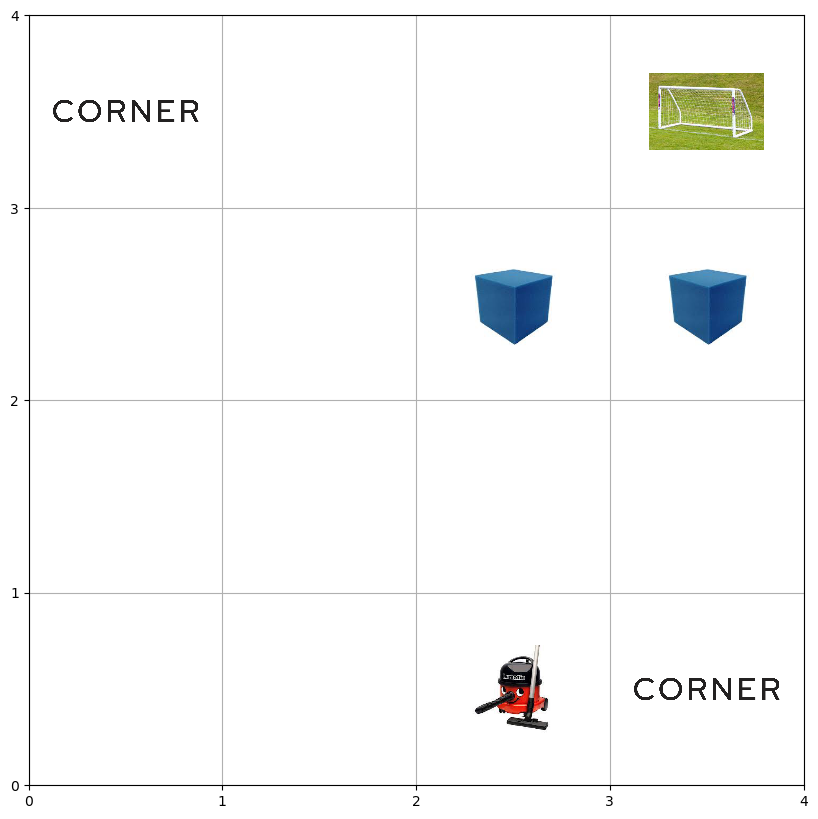

In [11]:
if __name__ == '__main__':
    env = RoomVacuum()
    agent = RandomAgent(env)

    observation, info = env.reset()
    terminated, truncated = False, False
    
    while not terminated:
        action = agent.step(obs)
        obs, reward, terminated, truncated, info = env.step(action)
        if truncated:
            print('Action:', action, ', truncated')
            truncated = False
        print('Action:', action, ', Reward:', reward, ', Done:', terminated)
        env.render()

In [12]:
def epsilon_decay_graph(epsilon_values):
    plt.figure()
    plt.plot(epsilon_values, linewidth=4)
    plt.xlabel('Episode', fontsize=20)
    plt.ylabel('Epsilon Value', fontsize=20)
    plt.title('Epsilon Decay', fontsize=24)
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)
    plt.ylim(ymin=0, ymax=1)
    plt.xlim(xmin=0, xmax=500)
    plt.grid()
    plt.show()



# SARSA Implementation

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.988
Episode: 0, reward gained: 16, Epsilon value: 0.988
Updated Q-table: [[ 0.     0.     0.     0.     0.     0.     0.     0.   ]
 [ 0.     0.     0.     0.     0.     0.     0.     0.   ]
 [ 0.     0.     0.     0.     0.     0.     0.     0.   ]
 [ 0.     0.     0.2    0.     0.     0.2    0.     0.   ]
 [ 0.     0.     0.     0.     0.     0.     0.     0.018]
 [ 0.     0.     0.     0.     0.     0.     0.     0.   ]
 [ 0.     0.     0.     0.     0.     0.     0.     0.   ]
 [ 0.     0.2    0.     0.     0.     0.     0.     0.   ]
 [ 

Episode: 270, reward gained: 84, Epsilon value: 0.1
Updated Q-table: [[12.27758891  1.41613319  0.47206689  1.73929905  0.8941798   2.30140903
   1.69195685  1.91598564]
 [ 0.30306448  0.19331348  0.81563013  0.15953857  6.75272711  1.17411293
   0.52361137  0.69795229]
 [ 0.78641118  2.60313186  3.71181708  1.08211107  2.67223722 12.74053741
   1.01599117  0.62815572]
 [ 7.24083399 11.16494384 12.01511677  8.87882293  6.54151486 13.86778693
   6.81123824  7.65472372]
 [ 6.31055408  3.13840744  1.37785815  5.26248967  4.71489719  1.07636576
   2.42248691 15.17659037]
 [ 0.62243     0.11564959  1.49781439  0.24784797  2.46623532  6.89007832
   0.03538692  1.01441   ]
 [ 3.54071576  1.74167283  1.29469188  0.557439    3.7706612  12.46038321
   0.1470434   0.65325651]
 [ 6.18239608 12.48096821  3.14353652  1.19860066  5.96923609  4.59931911
   2.36986199  4.23523881]
 [10.52182744  5.28208426 10.5241051   9.24496252  8.39398547  2.23180408
   6.9588954  18.1716455 ]
 [ 1.1957716   0.42398

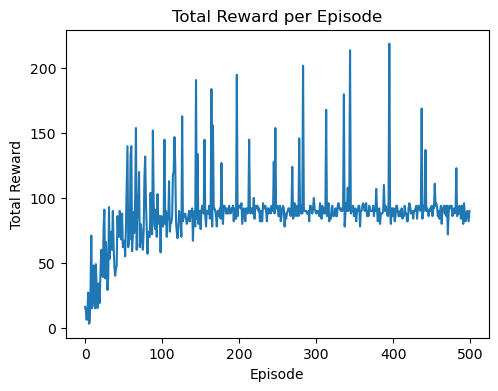

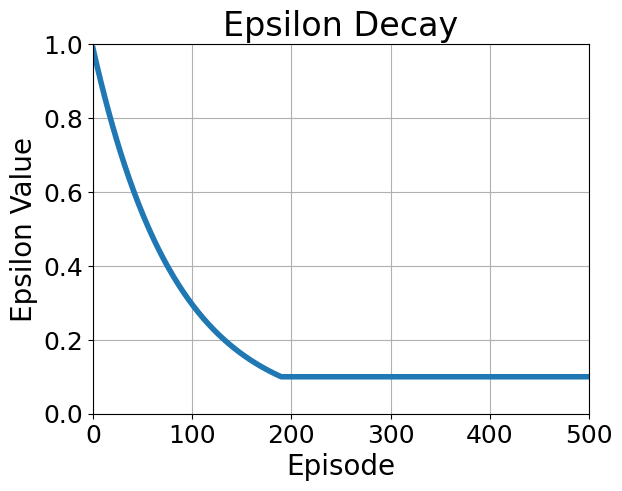

In [27]:
import numpy as np
import matplotlib.pyplot as plt

class SARSA:

    def __init__(self, env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500):
        self.env = env
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.num_episodes = num_episodes
        self.q_table = np.zeros((env.observation_space.n, env.action_space.n))
        self.epsilon_decay = epsilon_decay
        self.min_epsilon = min_epsilon
        self.epsilon_values = None

    def epsilon_greedy_policy(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.env.action_space.n)
        else:
            temp = np.argmax(self.q_table[state])
            return temp

    def epsilon_decaying(self):
        return max(self.min_epsilon, self.epsilon * self.epsilon_decay)

    def train(self):
        print(f'Initial Q-table: {self.q_table}')
        total_rewards = []
        self.epsilon_values = []

        for episode in range(self.num_episodes):
            state = self.env.reset()
            current_index = 0
            total_reward = 0
            action = self.epsilon_greedy_policy(current_index)
            current_index = 0
            self.epsilon = self.epsilon_decaying()
            print(self.epsilon)
            while True:
                observation, reward, done, truncated, _ = self.env.step(action)

                next_index = (self.env.agent_position[0] * self.env.GRID_SIZE) + self.env.agent_position[1]

                next_action = self.epsilon_greedy_policy(next_index)

                # SARSA update
                self.q_table[current_index, action] += self.alpha * \
                (reward + self.gamma * self.q_table[next_index, next_action] - self.q_table[current_index, action])

                action = next_action
                current_index = next_index
                total_reward += reward

                if done:
                    break
            self.epsilon_values.append(self.epsilon)
            print(f'Episode: {episode}, reward gained: {total_reward}, Epsilon value: {self.epsilon}')
            print(f'Updated Q-table: {self.q_table}')
            total_rewards.append(total_reward)
        
        print(f'Final Q-table: {self.q_table}')

        return total_rewards

def plot_results(total_rewards, epsilon_values=None):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(total_rewards)
    plt.title('Total Reward per Episode')
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')

    if epsilon_values is not None:
        plt.subplot(1, 2, 2)
        plt.plot(epsilon_values)
        plt.title('Epsilon Decay')
        plt.xlabel('Episode')
        plt.ylabel('Epsilon')

    plt.show()

env = RoomVacuum()

sarsa_agent = SARSA(env)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)

epsilon_decay_graph(sarsa_agent.epsilon_values)

# Hyperparameter Tuning Alpha

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.988
Episode: 0, reward gained: 17, Epsilon value: 0.988
Updated Q-table: [[ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.4      0.       0.     ]
 [ 0.072    0.41296  0.4      0.       0.       0.4      0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [-0.2      0.       0.  

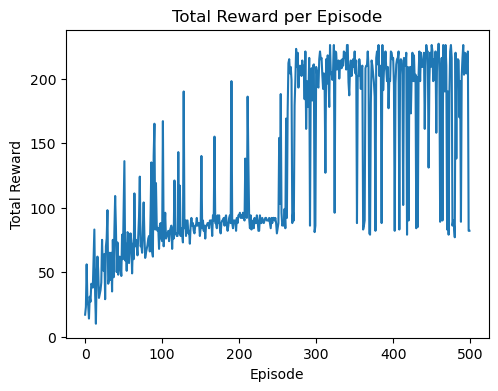

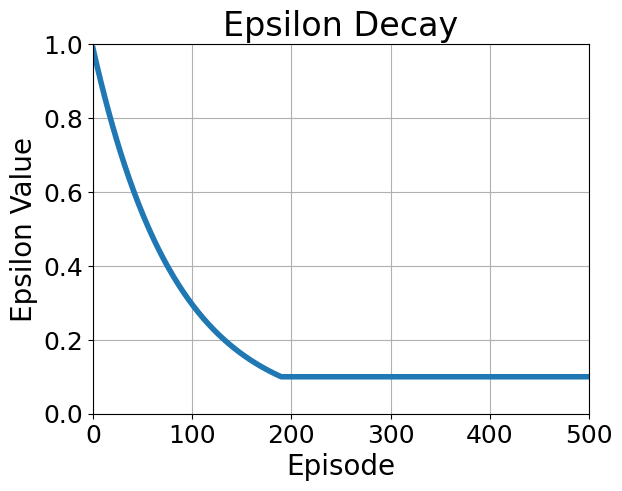

In [29]:
sarsa_agent = SARSA(env, alpha=0.2, gamma=0.9, epsilon=1, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.988
Episode: 0, reward gained: 5, Epsilon value: 0.988
Updated Q-table: [[ 0.      0.      0.      0.      0.      0.      0.      0.2025]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.225   0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.  

Episode: 401, reward gained: 223, Epsilon value: 0.1
Updated Q-table: [[19.37059116 21.89730443 19.37894053 22.26091466 22.57129592 17.54205783
  21.80943521 29.32162097]
 [ 8.96859691  8.95666657 19.76303956  8.50701599 29.97718152  6.29593641
   4.44875931  5.36733593]
 [33.26649356 20.24752706  6.935475    4.79511899 14.78303435 10.01075446
   3.03731578  8.09309776]
 [ 8.45841249  8.64030041  8.39642729  7.82351418 33.12846188  9.12926833
   8.08639424 15.6543971 ]
 [ 0.86181924  2.80224161 24.54855357  1.59452783 32.83457882 13.84488027
   2.51623663  1.58300258]
 [27.8085228  17.69141092 22.63059921 21.72171501 35.4630503  24.56940734
  23.40271278 16.16870004]
 [20.43515748  7.18880652 11.34368255  5.91898757 38.15729408 27.22838374
   6.75393774 12.99796841]
 [37.89791952  9.74819665 22.81227839  9.05578734 26.66479504 12.32609366
  16.85895045 18.79294671]
 [ 9.43942918  2.64211959 18.92254992  5.20434511  4.78659162  1.28832155
  26.21478834  4.13446297]
 [25.30224975  5.7791

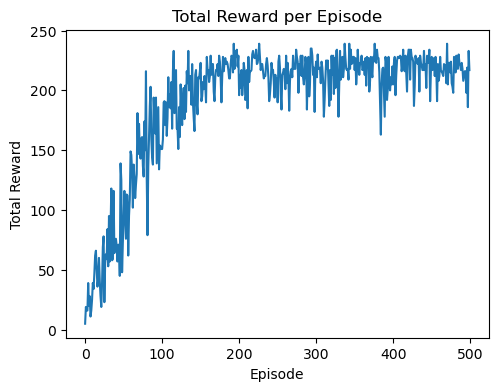

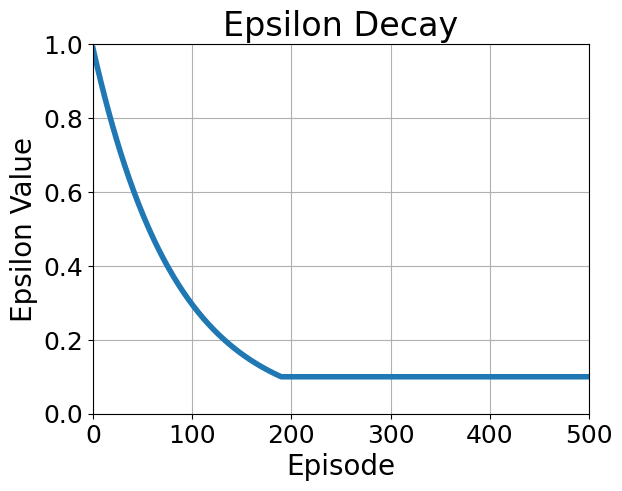

In [31]:
sarsa_agent = SARSA(env, alpha=0.5, gamma=0.9, epsilon=1, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.988
Episode: 0, reward gained: 28, Epsilon value: 0.988
Updated Q-table: [[ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.       0.       0.       0.       0.     ]
 [ 0.       0.       0.       0.      -0.91     0.       0.       0.     ]
 [ 0.       0.       0.  

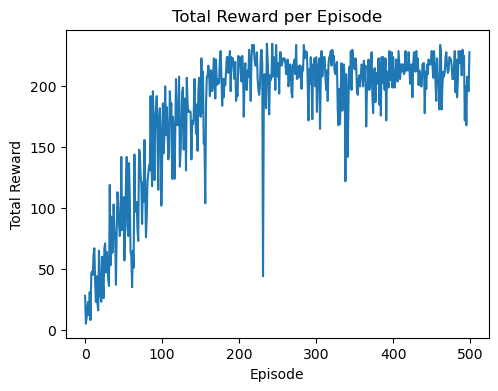

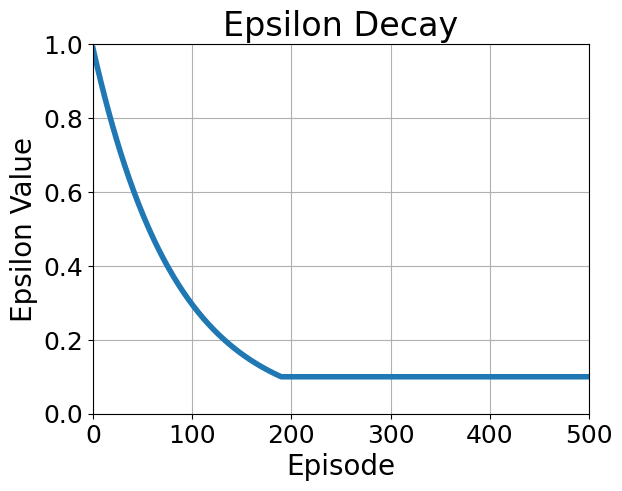

In [48]:
sarsa_agent = SARSA(env, alpha=0.7, gamma=0.9, epsilon=1, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

# Hyperparameter Tuning Epsilon

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.6916
Episode: 0, reward gained: 36, Epsilon value: 0.6916
Updated Q-table: [[ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.2
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.2
   0.          0.        ]
 [ 0.04395856  0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0. 

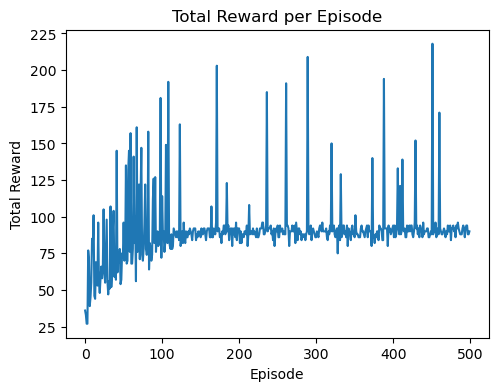

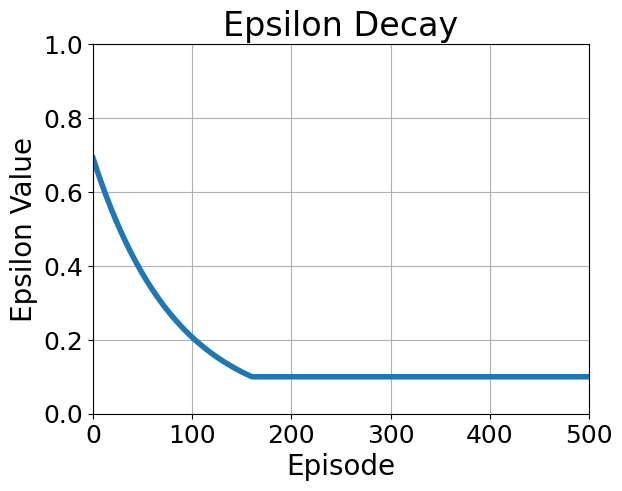

In [33]:
sarsa_agent = SARSA(env, alpha=0.1, gamma=0.9, epsilon=0.7, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.5928
Episode: 0, reward gained: 100, Epsilon value: 0.5928
Updated Q-table: [[ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.  

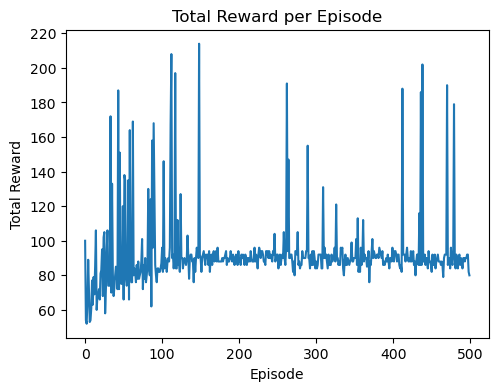

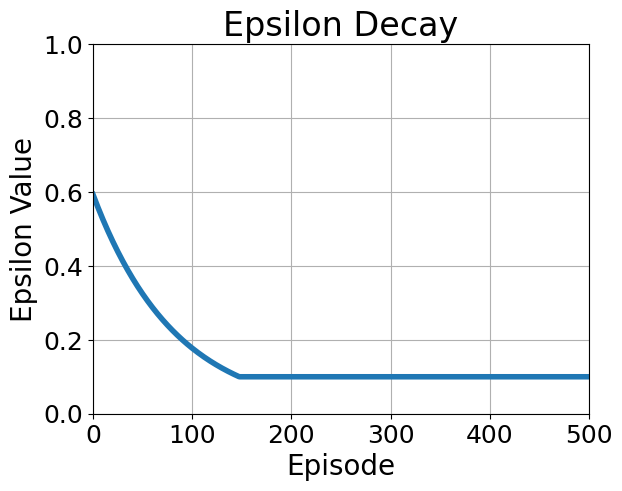

In [36]:
sarsa_agent = SARSA(env, alpha=0.1, gamma=0.9, epsilon=0.6, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987012
Episode: 0, reward gained: 11, Epsilon value: 0.987012
Updated Q-table: [[ 0.         0.         0.         0.         0.         0.
   0.         0.       ]
 [ 0.         0.         0.         0.         0.         0.
   0.         0.       ]
 [ 0.         0.         0.         0.         0.         0.
   0.         0.       ]
 [ 0.         0.         0.         0.         0.         0.
   0.         0.       ]
 [ 0.         0.         0.         0.         0.         0.
   0.         0.       ]
 [ 0.         0.         0.         0. 

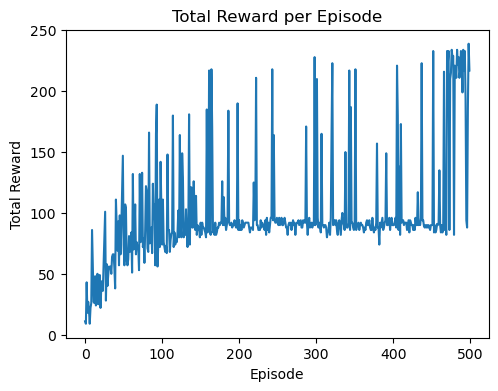

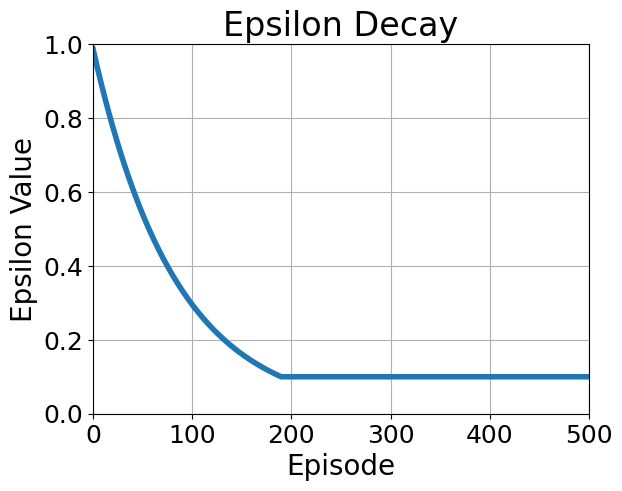

In [37]:
sarsa_agent = SARSA(env, alpha=0.1, gamma=0.9, epsilon=0.999, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = sarsa_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(sarsa_agent.epsilon_values)

# Double Q-Learning

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 14, Epsilon value: 0.987
Updated Q-table1: [[ 0.     0.     0.   

Episode: 225, reward gained: 162, Epsilon value: 0.1
Updated Q-table1: [[1.50355510e+00 2.77062744e+00 2.08735566e+00 1.55324533e+00
  1.61481505e+01 5.50899549e-01 3.96628452e+00 1.27762444e+00]
 [3.38238505e-02 3.01904199e-01 8.41898724e+00 3.54052207e-02
  7.48779597e-02 1.76497622e+00 1.59226083e-01 1.48196288e+00]
 [1.25018253e+00 2.92151453e+00 1.63585675e+01 5.92403705e-01
  1.45509097e+00 3.00365632e+00 6.55804825e-01 3.63168443e+00]
 [8.90674741e+00 1.46064149e+01 1.96672564e+01 1.12548328e+01
  8.76752138e+00 1.30690074e+01 1.01710182e+01 6.83892692e+00]
 [8.61202916e-01 4.20832067e-01 1.60244135e+00 6.53311864e-01
  1.79356262e+00 4.74380924e-01 6.03796810e-01 1.48558456e+01]
 [2.99398848e+00 4.51684998e-01 3.07303303e+00 6.47809184e-01
  1.28794307e+01 4.21387277e+00 2.92939454e+00 1.79855429e+01]
 [7.51798166e-02 2.22409798e+00 9.99091514e-01 1.63612002e-01
  2.25925330e+00 1.32305647e+01 9.87790371e-02 1.45855257e+00]
 [1.56937561e+00 4.56018745e+00 1.28031645e+00 5.36530

Episode: 391, reward gained: 88, Epsilon value: 0.1
Updated Q-table1: [[4.59231644e+00 5.01286683e+00 2.55293248e+00 1.55324533e+00
  1.61998204e+01 5.50899549e-01 5.98281223e+00 1.27762444e+00]
 [3.38238505e-02 3.01904199e-01 9.98519756e+00 3.54052207e-02
  7.48779597e-02 1.76497622e+00 1.59226083e-01 1.48196288e+00]
 [1.25018253e+00 2.92151453e+00 1.77859197e+01 5.92403705e-01
  1.45509097e+00 3.00365632e+00 6.55804825e-01 3.63168443e+00]
 [1.00057191e+01 1.56126432e+01 1.99241877e+01 1.22822324e+01
  9.85924367e+00 1.37493129e+01 1.01710182e+01 7.69241074e+00]
 [8.61202916e-01 4.20832067e-01 1.60244135e+00 6.53311864e-01
  1.79356262e+00 4.74380924e-01 6.03796810e-01 1.63290674e+01]
 [2.99398848e+00 1.08082888e+00 3.07303303e+00 1.86298444e+00
  1.75518543e+01 4.21387277e+00 5.14220050e+00 1.79999941e+01]
 [7.51798166e-02 2.22409798e+00 9.99091514e-01 1.63612002e-01
  2.25925330e+00 1.44800252e+01 9.87790371e-02 1.45855257e+00]
 [1.56937561e+00 6.07457287e+00 1.28031645e+00 5.365306

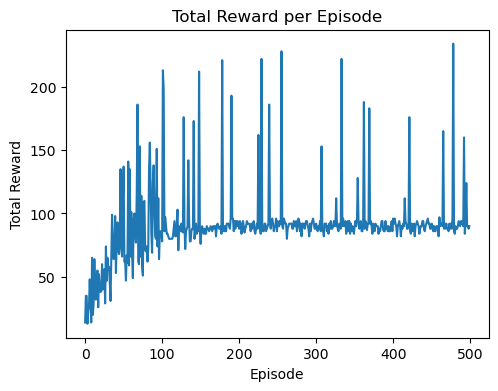

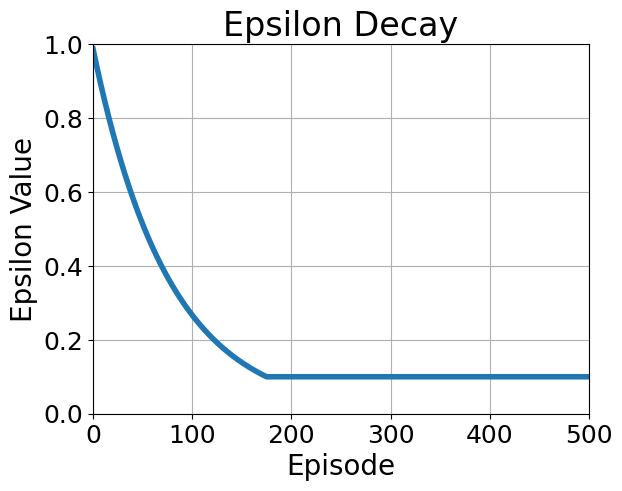

In [20]:
class DoubleQLearning:

    def __init__(self, env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=500):
        self.env = env
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.num_episodes = num_episodes
        self.q_table1 = np.zeros((env.observation_space.n, env.action_space.n))
        self.q_table2 = np.zeros((env.observation_space.n, env.action_space.n))
        self.epsilon_decay = epsilon_decay
        self.min_epsilon = min_epsilon
        self.epsilon_values = None

    def epsilon_greedy_policy(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.env.action_space.n)
        else:
            q_tables_summation = self.q_table1[state] + self.q_table2[state]
            temp = np.argmax(q_tables_summation)
            return temp

    def epsilon_decaying(self):
        return max(self.min_epsilon, self.epsilon * self.epsilon_decay)

    def train(self):
        print(f'Initial Q-table1: {self.q_table1}')
        print(f'Initial Q-table2: {self.q_table2}')
        total_rewards = []
        self.epsilon_values = []

        for episode in range(self.num_episodes):
            state = self.env.reset()
            current_index = 0
            total_reward = 0
            action = self.epsilon_greedy_policy(current_index)
            current_index = 0
            self.epsilon = self.epsilon_decaying()
            print(self.epsilon)
            while True:
                observation, reward, done, truncated, _ = self.env.step(action)

                next_index = (self.env.agent_position[0] * self.env.GRID_SIZE) + self.env.agent_position[1]

                # Double Q-Learning update
                if np.random.rand() < 0.5:
                    self.q_table1[current_index, action] += self.alpha * (reward + self.gamma * \
                        self.q_table2[next_index, np.argmax(self.q_table1[next_index])] - self.q_table1[current_index, action])
                else:
                    self.q_table2[current_index, action] += self.alpha * (reward + self.gamma * \
                        self.q_table1[next_index, np.argmax(self.q_table2[next_index])] - self.q_table2[current_index, action])
                    
                action = self.epsilon_greedy_policy(next_index)
                current_index = next_index
                total_reward += reward

                if done:
                    break
            self.epsilon_values.append(self.epsilon)
            print(f'Episode: {episode}, reward gained: {total_reward}, Epsilon value: {self.epsilon}')
            print(f'Updated Q-table1: {self.q_table1}')
            print(f'Updated Q-table2: {self.q_table2}')
            total_rewards.append(total_reward)
        
        print(f'Final Q-table1: {self.q_table1}')
        print(f'Final Q-table2: {self.q_table2}')

        return total_rewards

def plot_results(total_rewards, epsilon_values=None):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(total_rewards)
    plt.title('Total Reward per Episode')
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')

    if epsilon_values is not None:
        plt.subplot(1, 2, 2)
        plt.plot(epsilon_values)
        plt.title('Epsilon Decay')
        plt.xlabel('Episode')
        plt.ylabel('Epsilon')

    plt.show()

env = RoomVacuum()

doubleQLearning_agent = DoubleQLearning(env)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)

epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

# Hyperparameter tuning Discount Factor (Gamma)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 23, Epsilon value: 0.987
Updated Q-table1: [[ 0.     0.     0.   

Episode: 265, reward gained: 84, Epsilon value: 0.1
Updated Q-table1: [[3.60179266e+01 6.34797102e+00 1.52899916e-01 9.15551780e+00
  1.36554027e+00 1.45060507e+00 1.03258520e+01 4.07456075e+00]
 [9.54995636e-01 3.46293500e-01 1.14519307e+01 8.98997339e-03
  1.17954543e+00 6.18984093e-01 1.76656091e-01 4.37081681e+00]
 [5.29698362e-01 3.48163718e+00 3.95941166e+00 1.25254005e-01
  2.68433041e+00 2.78212827e+01 6.36394210e-01 1.56837705e+00]
 [1.21108395e+01 3.39435298e+01 1.95417601e+01 1.22132564e+01
  1.15977343e+01 1.83852260e+01 1.16926483e+01 8.92411987e+00]
 [3.79919957e+01 1.77851313e+00 1.56385295e+00 7.34443100e-01
  9.57190758e+00 2.51487134e+00 3.10990347e-01 1.85944041e+01]
 [3.70861959e+00 6.40253312e-01 1.72470671e+00 2.66313172e+00
  8.32325246e-01 4.44214374e+00 6.35101581e-02 2.77849940e+01]
 [2.21955700e+00 3.77503832e+00 1.58932677e+00 3.86904011e-01
  3.33624278e+00 1.62484752e+01 4.35585511e-01 4.50733953e-01]
 [7.29871678e+00 2.59911188e+01 1.98811135e+00 3.580971

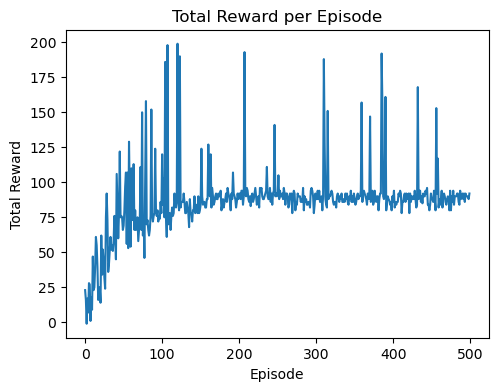

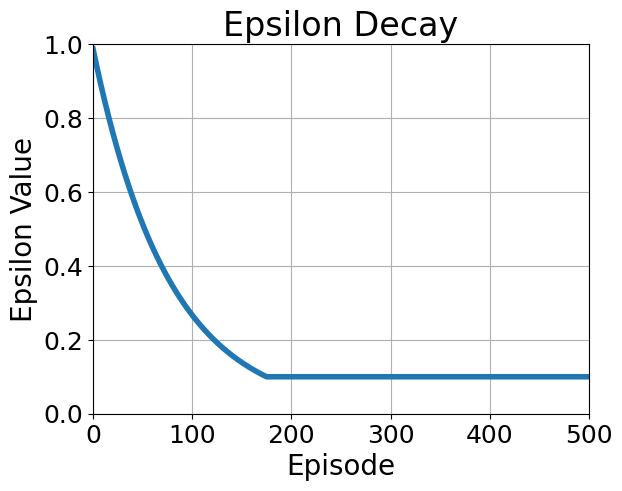

In [21]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.95, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 2, Epsilon value: 0.987
Updated Q-table1: [[ 0.    0.    0.    0.

Episode: 225, reward gained: 94, Epsilon value: 0.1
Updated Q-table1: [[ 0.88199322  0.56642319  1.11470159  0.50816111  0.66195357  3.26413523
   1.02492463  0.45656478]
 [ 1.07528346  0.80138847  1.36442373  0.52296011  0.97992823  4.66593524
   0.31869666  0.8408444 ]
 [ 2.86670942  1.89051413  3.57421495  1.65506738  3.08186548  6.66666666
   1.41220668  1.31973009]
 [ 4.66455019  6.66610641  6.66666667  4.66137133  4.65460757  6.64143511
   4.6614523   4.66264901]
 [ 3.59813339  0.          0.2359062   0.12439155  0.36407362  0.35368601
   0.16292496  0.19575174]
 [ 0.69961412  0.17025075  4.2668717   0.2597908   1.42657523  0.74670506
   0.02121972  0.6589802 ]
 [ 2.25078408  2.90846844  1.36336545  0.33934524  3.29849228  6.66640094
   1.4050646   1.62680272]
 [ 4.46107925  6.66662068  0.97308979  2.34388749  3.06676943  4.11867537
   2.3817328   2.28808027]
 [ 6.61601098  0.27455372  0.028462    1.19281967  0.88503177  1.00668851
   0.26461887  3.57435298]
 [ 0.80708932  0.1128

Episode: 425, reward gained: 213, Epsilon value: 0.1
Updated Q-table1: [[ 1.06378548  0.73844732  1.52356399  0.99013567  0.66195357  3.2666665
   1.02492463  0.85073852]
 [ 1.24129282  0.80138847  1.99184989  0.85806243  1.68040768  4.66666665
   1.12445072  0.8408444 ]
 [ 3.20867517  2.16812938  4.6377091   1.96126134  3.38297653  6.66666667
   1.59765122  1.70337042]
 [ 4.67744536  6.66666632  6.66666667  4.66664456  5.0404208   6.66642198
   4.66662571  4.666633  ]
 [ 3.98955152  0.          0.2359062   0.12439155  0.36407362  0.35368601
   0.16292496  0.19575174]
 [ 0.69961412  0.17025075  4.45418311  0.2597908   1.42657523  0.74670506
   0.02121972  0.6589802 ]
 [ 2.25078408  3.08428827  1.36336545  0.33934524  5.52765652  6.66666543
   1.5912248   1.62680272]
 [ 9.94146     6.66666665  0.97308979  2.57615639  4.65188314  4.80918101
   3.00094988  4.37387276]
 [ 6.6470148   0.27455372  0.46576277  1.19281967  0.88503177  1.00668851
   0.26461887  3.57435298]
 [ 0.80708932  0.1128

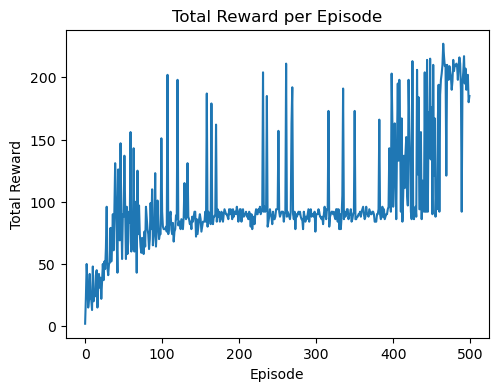

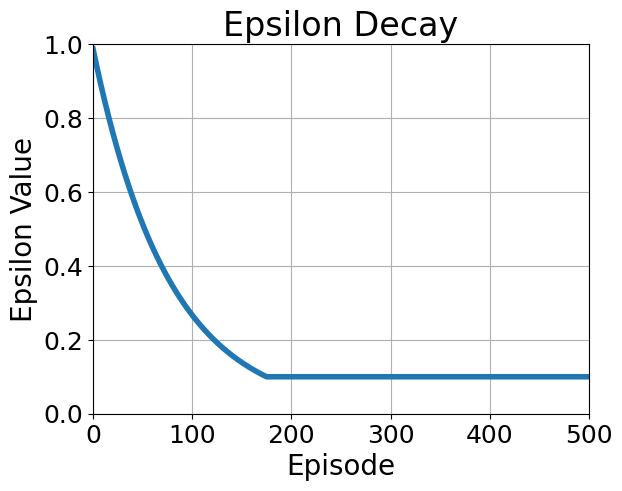

In [38]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.7, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 24, Epsilon value: 0.987
Updated Q-table1: [[ 0.     0.     0.   

Episode: 175, reward gained: 86, Epsilon value: 0.1
Updated Q-table1: [[ 0.26587992  0.14549903  0.1478975   0.16765365  0.26510911  0.99404149
   0.13560528  0.17332863]
 [ 0.26671504  0.17956183  1.99917583  0.09148786  0.59007185  0.59270701
   0.13719701  0.10846392]
 [ 1.5733124   1.4456087   3.04198263  0.45172584  1.26849503  3.9999994
   0.65231609  0.68880148]
 [ 1.98563954  3.99565169  4.          1.99793109  1.98274164  3.99850466
   1.99230142  1.98534362]
 [ 1.51255624  0.03762155  0.03751629  0.01927717  0.13032655  0.17626403
   0.01836425  0.39438749]
 [ 0.26202984  0.17513426  0.54527315  0.0524141  -0.33873225  1.76353696
   0.01520997  0.65319061]
 [ 0.66323307  0.89167241  1.10420512  0.24382801  1.69953741  3.99809806
   0.38799944  0.54796315]
 [ 1.63324678  3.999833    1.02202771  1.00410491  2.0104073   3.09730449
   0.89940053  1.38382925]
 [ 3.89745941  0.07723578  0.22992781  0.4398901   0.04443993  0.35498596
   0.15919206  1.85047532]
 [ 0.18626321  0.04355

Episode: 371, reward gained: 92, Epsilon value: 0.1
Updated Q-table1: [[ 0.35676423  0.1809488   0.2331077   0.20088592  0.39266184  0.99999957
   0.17204453  0.22786042]
 [ 0.33337142  0.33544507  1.99999987  0.13233413  0.73106325  0.59270701
   0.13719701  0.17643778]
 [ 1.68875417  1.63626387  3.43430032  0.50655282  1.61124549  4.
   0.7183734   0.78789054]
 [ 1.99992539  3.99996926  4.          1.99999587  1.99996864  3.99998695
   1.99998463  1.99995207]
 [ 1.7304228   0.03762155  0.03751629  0.01927717  0.13032655  0.17626403
   0.01836425  0.39438749]
 [ 0.26202984  0.17513426  0.54527315  0.0524141  -0.33873225  1.93989427
   0.01520997  0.65319061]
 [ 1.21657456  0.89167241  1.10420512  0.24382801  1.69953741  3.99999285
   0.44919945  0.54796315]
 [ 1.96175068  3.99999999  1.20783693  1.00410491  2.30201223  3.26881664
   1.00946048  1.60915628]
 [ 3.92524791  0.07723578  0.38913272  0.4398901   0.04443993  0.35498596
   0.15919206  1.85047532]
 [ 0.18626321  0.04355107  0.

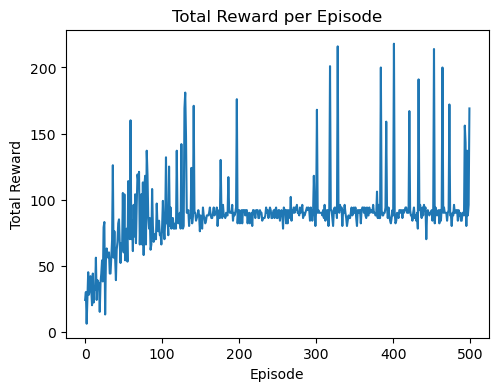

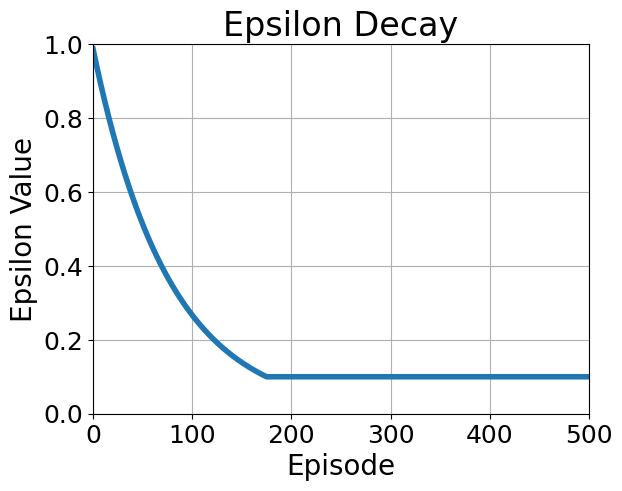

In [39]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.5, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=500)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

# Hyperparameter Tuning max episodes

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 6, Epsilon value: 0.987
Updated Q-table1: [[ 0.    0.    0.    0.

Episode: 239, reward gained: 84, Epsilon value: 0.1
Updated Q-table1: [[6.96806132e-01 1.43990357e+00 2.43099747e+00 9.27132917e-01
  1.61487322e+01 2.63246511e+00 5.88002214e-01 1.90466068e+00]
 [3.23968022e-01 1.18413868e+00 9.56320091e-01 1.69513061e+00
  1.06296770e+00 1.50254870e+01 7.36028659e-01 1.45222783e+00]
 [7.45927124e+00 6.99707492e+00 9.93882773e+00 6.80672968e+00
  8.09325885e+00 1.99999969e+01 3.84750618e+00 7.39363814e+00]
 [1.79241967e+01 1.99760864e+01 2.00000000e+01 1.78925761e+01
  1.78311350e+01 1.99704409e+01 1.78770599e+01 1.75356753e+01]
 [1.05055734e+01 6.22998561e-01 9.88673583e-01 1.14869188e-01
  5.77902448e-01 2.32477450e-01 1.99785142e-02 9.07206352e-01]
 [5.40501446e+00 9.09325999e-01 4.03071142e+00 1.14704217e+00
  1.83268093e+00 1.79900242e+01 2.43152352e+00 5.36018500e+00]
 [1.76990651e+00 1.34812045e+00 8.40630083e+00 3.32462409e+00
  5.12420151e-01 1.99797454e+01 1.20582153e+00 2.18268982e+00]
 [7.71616749e+00 1.99996567e+01 5.43493167e+00 3.210643

Episode: 426, reward gained: 90, Epsilon value: 0.1
Updated Q-table1: [[6.96806132e-01 2.75388374e+00 4.74496617e+00 9.27132917e-01
  1.61999700e+01 3.86752724e+00 3.24601357e+00 3.10523583e+00]
 [3.23968022e-01 1.18413868e+00 9.56320091e-01 1.69513061e+00
  1.06296770e+00 1.65772988e+01 2.11943923e+00 1.45222783e+00]
 [9.46055626e+00 9.08763069e+00 1.26654054e+01 8.30600217e+00
  9.97548578e+00 2.00000000e+01 4.94754294e+00 9.06676508e+00]
 [1.79988688e+01 1.99999102e+01 2.00000000e+01 1.79990624e+01
  1.79995332e+01 1.99997420e+01 1.79969224e+01 1.79899369e+01]
 [1.22709828e+01 6.22998561e-01 9.88673583e-01 1.14869188e-01
  5.77902448e-01 2.32477450e-01 1.99785142e-02 2.53688309e+00]
 [8.15386433e+00 4.64310394e+00 6.67883256e+00 1.81775996e+00
  1.83268093e+00 1.79999980e+01 3.64546270e+00 5.36018500e+00]
 [1.76990651e+00 1.34812045e+00 9.36567072e+00 3.32462409e+00
  4.41261168e+00 1.99999501e+01 1.20582153e+00 4.77096843e+00]
 [1.37093902e+01 1.99999999e+01 5.43493167e+00 4.681409

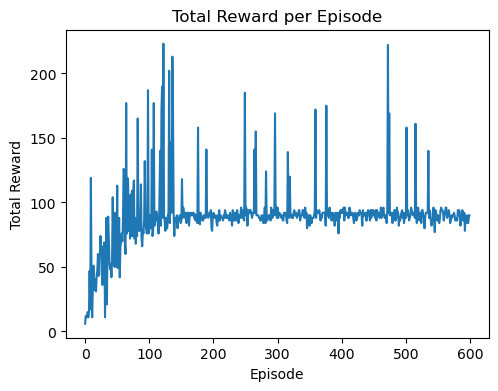

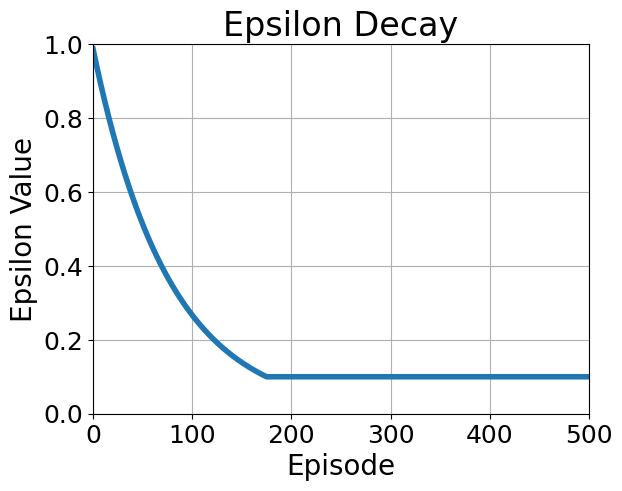

In [24]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=600)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 41, Epsilon value: 0.987
Updated Q-table1: [[ 0.       0.       0

Episode: 181, reward gained: 92, Epsilon value: 0.1
Updated Q-table1: [[3.10863095e+00 3.72832224e-01 8.43899207e-01 5.95116710e-02
  1.36598096e+00 8.00957599e-01 9.38781707e-01 1.58818151e+01]
 [1.62271777e-01 4.06661369e-01 1.61034405e+00 2.57073892e-01
  0.00000000e+00 6.98092131e+00 3.61938809e-01 4.73747946e-01]
 [2.55963355e+00 2.69005976e+00 1.63349263e+01 5.51940927e-01
  1.22871349e+00 7.10362116e+00 1.96958673e+00 1.12734033e+00]
 [7.37574858e+00 1.27924545e+01 1.22073072e+01 9.23210203e+00
  6.49204553e+00 1.92321439e+01 7.45844626e+00 1.13023774e+01]
 [4.76672844e+00 4.77282126e-01 1.81505614e+00 4.49052839e+00
  4.39642265e+00 1.43850073e+00 2.59161715e+00 1.78171384e+01]
 [1.93167597e-01 8.81803245e-02 1.53954497e+00 9.59318346e-01
  2.01924535e+00 7.42234758e+00 1.31106206e-01 2.84892876e-01]
 [1.88005833e+00 4.73145374e-01 1.73331629e-01 4.18264968e-02
  2.02461908e+01 2.54693401e+00 3.93419306e-01 3.79944923e+00]
 [7.29122264e+00 1.59305360e+01 6.57027009e-01 1.160780

Episode: 372, reward gained: 86, Epsilon value: 0.1
Updated Q-table1: [[5.59522101e+00 1.77273444e+00 8.43899207e-01 2.81833384e+00
  1.36598096e+00 1.70327856e+00 5.60505906e+00 1.61999498e+01]
 [1.62271777e-01 4.06661369e-01 1.61034405e+00 2.57073892e-01
  0.00000000e+00 9.78722921e+00 3.61938809e-01 4.73747946e-01]
 [2.55963355e+00 2.69005976e+00 1.92869035e+01 1.47916356e+00
  1.22871349e+00 7.10362116e+00 1.96958673e+00 2.29111830e+00]
 [9.13965948e+00 1.35011918e+01 1.42243579e+01 1.07238322e+01
  9.09490155e+00 1.99152500e+01 1.28348848e+01 1.51196813e+01]
 [6.09005560e+00 1.84030961e+00 2.81161475e+00 4.49052839e+00
  5.74726393e+00 2.21972492e+00 4.86929626e+00 1.79999946e+01]
 [1.93167597e-01 8.81803245e-02 1.53954497e+00 9.59318346e-01
  2.01924535e+00 1.06970610e+01 1.31106206e-01 2.84892876e-01]
 [1.88005833e+00 4.73145374e-01 1.73331629e-01 4.18264968e-02
  3.09596703e+01 2.54693401e+00 3.93419306e-01 3.79944923e+00]
 [7.29122264e+00 1.83002805e+01 2.00382355e+00 3.726337

Episode: 543, reward gained: 88, Epsilon value: 0.1
Updated Q-table1: [[5.59522101e+00 7.77368953e+00 1.74192601e+00 3.99449404e+00
  2.56069702e+00 2.57517769e+00 5.60505906e+00 1.62000000e+01]
 [1.62271777e-01 4.06661369e-01 1.61034405e+00 2.57073892e-01
  0.00000000e+00 1.34670238e+01 3.61938809e-01 4.73747946e-01]
 [2.55963355e+00 2.69005976e+00 1.97954454e+01 1.47916356e+00
  1.22871349e+00 7.10362116e+00 1.96958673e+00 2.29111830e+00]
 [1.08401416e+01 1.47229394e+01 1.57758839e+01 1.20542250e+01
  1.13200937e+01 1.99811874e+01 1.33252070e+01 1.93424255e+01]
 [6.09005560e+00 3.11427853e+00 3.93060923e+00 4.49052839e+00
  6.97252744e+00 2.21972492e+00 7.50089533e+00 1.80000000e+01]
 [1.93167597e-01 8.81803245e-02 1.53954497e+00 9.59318346e-01
  2.01924535e+00 1.30653786e+01 1.31106206e-01 2.84892876e-01]
 [1.88005833e+00 4.73145374e-01 1.73331629e-01 4.18264968e-02
  3.22274529e+01 2.54693401e+00 3.93419306e-01 3.79944923e+00]
 [7.29122264e+00 1.92475106e+01 2.00382355e+00 3.726337

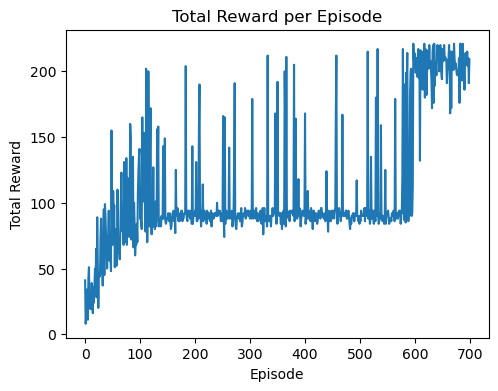

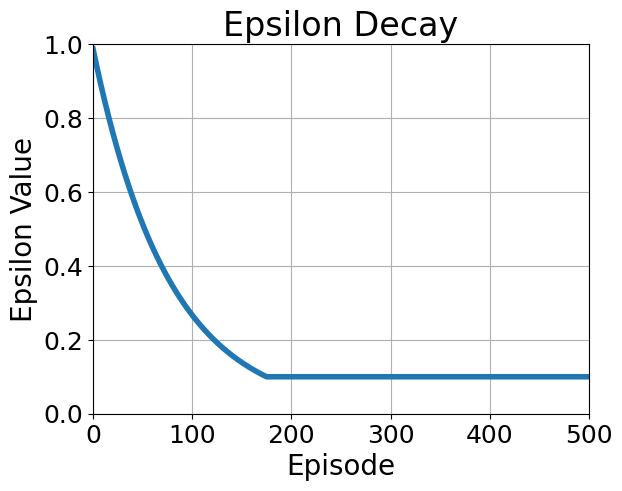

In [70]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=700)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

In [43]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=720)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 24, Epsilon value: 0.987
Updated Q-table1: [[ 0.0e+00  0.0e+00  0

Episode: 238, reward gained: 92, Epsilon value: 0.1
Updated Q-table1: [[ 1.05926305e+00  3.52462592e-01  1.23906642e+00  7.06236614e-01
   8.67916597e-01  2.40088938e+00  2.92132488e+00  1.61676681e+01]
 [ 3.00803993e-01  4.50406280e-02  1.16649138e+01  1.76941876e-02
   0.00000000e+00  5.35760317e-01  2.79599600e-01  1.57194428e+00]
 [ 1.60937416e+00  4.00223138e+00  1.90120584e+00  1.18269518e+00
   1.81363250e+00  1.64627203e+01  1.17480343e+00  4.97943620e-01]
 [ 3.59013573e+00  1.97280345e+01  1.38399620e+01  7.58198803e+00
   6.89900602e+00  1.27835415e+01  1.05385969e+01  6.37609906e+00]
 [ 1.79991320e+01  3.25751983e-01  3.12510002e+00  3.64870957e+00
   7.02972497e+00  1.70216648e+00  5.17350272e-01  5.70657503e+00]
 [ 4.61061792e-01  8.44871015e-01  4.29827665e-01  2.97645739e+00
  -7.65086529e-02  1.10691356e+00  9.56446975e-02  1.15119415e+01]
 [ 2.05432420e+00  7.09991246e-01  1.03349127e+00  3.11610515e-02
   3.67518780e+00  1.22505220e+01  1.01753717e+00  7.41352053e-02]

Episode: 451, reward gained: 204, Epsilon value: 0.1
Updated Q-table1: [[2.57332123e+00 3.05558538e+00 2.79222905e+00 7.06236614e-01
  1.83587829e+00 2.93449839e+00 6.93055778e+00 1.76159871e+01]
 [3.00803993e-01 4.50406280e-02 1.37987035e+01 1.76941876e-02
  0.00000000e+00 5.35760317e-01 2.79599600e-01 1.57194428e+00]
 [1.60937416e+00 4.00223138e+00 1.90120584e+00 1.18269518e+00
  1.81363250e+00 1.88504233e+01 1.17480343e+00 4.97943620e-01]
 [6.67570787e+00 1.99821470e+01 1.50067028e+01 9.42305921e+00
  8.41768504e+00 1.56990588e+01 1.17797839e+01 8.67862948e+00]
 [2.26691568e+01 3.25751983e-01 3.73475465e+00 6.03340645e+00
  8.12645478e+00 1.70216648e+00 5.17350272e-01 8.10876209e+00]
 [4.61061792e-01 8.44871015e-01 4.29827665e-01 2.97645739e+00
  3.45071303e+00 1.10691356e+00 9.56446975e-02 1.42965270e+01]
 [2.05432420e+00 7.09991246e-01 1.03349127e+00 3.11610515e-02
  3.67518780e+00 1.66381637e+01 1.01753717e+00 7.41352053e-02]
 [2.94041523e+00 1.96305398e+00 2.26443484e+00 2.07779

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.988
Episode: 0, reward gained: 2, Epsilon value: 0.988
Updated Q-table1: [[ 0.   0.   0.   0.   

Episode: 285, reward gained: 84, Epsilon value: 0.1
Updated Q-table1: [[ 1.61964706e+01  4.66881689e+00  2.00520292e+00  5.24729278e+00
   2.43948468e+00  1.54609432e+00  3.19086916e+00  3.99297861e+00]
 [ 1.30166687e+00  4.93329098e-02  1.01141918e+01  8.70716600e-01
   1.95292116e-01  9.99895835e-01  1.21118263e-02  1.36547427e+00]
 [ 1.58368606e+00  2.69111333e+00  2.95140754e+00  8.61075353e-01
   1.11209792e+00  1.75451704e+01  1.34041063e+00  2.94370624e-01]
 [ 6.21273948e+00  1.31241351e+01  1.95471161e+01  1.01358637e+01
   7.26199077e+00  1.44817500e+01  8.51210215e+00  6.72554017e+00]
 [ 1.79996075e+01  3.12262011e+00  1.10587234e+00  6.44333586e+00
   5.45963070e+00  2.20714308e+00  5.69025052e+00  1.19916843e+00]
 [ 1.18345853e+00  5.10030463e-01  5.14198399e-01  5.39897397e-01
   1.79872558e-01  2.42917532e+00  1.00004220e-03  1.30534450e+01]
 [ 1.58700532e+00  3.52253760e+00  5.69090660e-02  8.26349858e-01
   2.85716837e+00  1.19987898e+01  3.52161439e-01  2.30909645e+00]

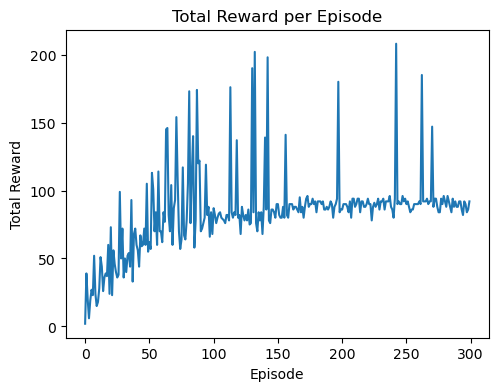

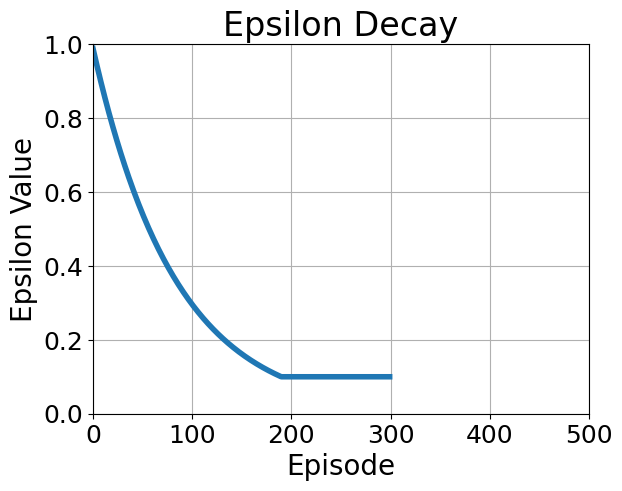

In [59]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.988, min_epsilon = 0.1, num_episodes=300)

total_rewards_base = doubleQLearning_agent.train()

plot_results(total_rewards_base)
epsilon_decay_graph(doubleQLearning_agent.epsilon_values)

Initial Q-table1: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
Initial Q-table2: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 28, Epsilon value: 0.987
Updated Q-table1: [[ 0.    0.    0.    0

Episode: 241, reward gained: 92, Epsilon value: 0.1
Updated Q-table1: [[1.51573595e+00 5.75101385e+00 1.13566346e+00 1.94203628e+00
  9.02432635e+00 2.06161138e+00 9.51632105e-01 1.61198818e+01]
 [1.56590651e-01 5.17625141e-01 5.49761033e-01 4.63174204e-02
  4.12849624e-01 8.62240226e+00 2.25988047e-02 8.22372023e-01]
 [9.67266177e-01 3.43859736e+00 1.60681085e+01 1.35933751e+00
  2.07888167e+00 4.18395816e+00 8.67617851e-01 1.18430630e+00]
 [6.93555171e+00 1.08726398e+01 9.45141006e+00 7.12458081e+00
  8.94477673e+00 1.90529294e+01 8.77069930e+00 7.16642335e+00]
 [1.79979844e+01 1.24514711e+00 3.85384570e+00 5.07459388e+00
  6.57516481e+00 1.66771260e+00 2.98468841e+00 6.46342220e+00]
 [8.05810069e-01 5.34073043e-01 2.40005886e+00 8.83530084e-01
  1.83070902e+01 1.31889263e+00 2.45368821e-03 1.37885777e+00]
 [8.93410389e-01 7.64882862e-01 2.26512976e+00 2.35012185e-02
  1.54972269e+00 1.27795439e+01 5.77510686e-01 2.77251832e+00]
 [3.72127175e+00 1.49446528e+01 1.48497936e+00 1.783563

Episode: 444, reward gained: 94, Epsilon value: 0.1
Updated Q-table1: [[2.98409174e+00 6.63389832e+00 1.13566346e+00 4.34318110e+00
  1.08856624e+01 2.64688067e+00 2.31446875e+00 1.61999974e+01]
 [1.56590651e-01 5.17625141e-01 5.49761033e-01 4.63174204e-02
  4.12849624e-01 1.10658130e+01 2.25988047e-02 8.22372023e-01]
 [9.67266177e-01 3.43859736e+00 1.86737848e+01 2.07487799e+00
  2.07888167e+00 5.67746658e+00 8.67617851e-01 3.99171016e+00]
 [7.90615694e+00 1.49787333e+01 1.29772247e+01 8.01422361e+00
  1.18657394e+01 1.98983017e+01 1.09793488e+01 9.71076459e+00]
 [1.79999998e+01 3.77783058e+00 3.85384570e+00 7.18824648e+00
  6.57516481e+00 3.53030467e+00 6.12698628e+00 7.61707998e+00]
 [8.05810069e-01 5.34073043e-01 2.40005886e+00 8.83530084e-01
  3.27456657e+01 2.64109946e+00 2.45368821e-03 1.37885777e+00]
 [8.93410389e-01 7.64882862e-01 2.26512976e+00 2.35012185e-02
  1.54972269e+00 1.46188477e+01 5.77510686e-01 2.77251832e+00]
 [3.72127175e+00 1.68750436e+01 1.48497936e+00 1.783563

Episode: 645, reward gained: 203, Epsilon value: 0.1
Updated Q-table1: [[4.30568257e+00 7.70999494e+00 3.80615581e+00 5.74857484e+00
  1.57049091e+01 2.64688067e+00 3.54102187e+00 2.57393998e+01]
 [1.56590651e-01 5.17625141e-01 5.49761033e-01 4.63174204e-02
  2.01532139e+00 1.26884133e+01 2.25988047e-02 8.22372023e-01]
 [9.67266177e-01 3.43859736e+00 1.94065246e+01 3.09918358e+00
  2.07888167e+00 7.10790886e+00 8.67617851e-01 3.99171016e+00]
 [1.04494205e+01 1.70208971e+01 1.62453770e+01 1.04794172e+01
  1.37322532e+01 1.99909618e+01 1.30748819e+01 1.17006316e+01]
 [3.25140854e+01 4.85804752e+00 9.24641128e+00 8.66514721e+00
  7.71762810e+00 4.19427604e+00 7.72942979e+00 7.61707998e+00]
 [8.05810069e-01 5.34073043e-01 2.40005886e+00 8.83530084e-01
  4.38179568e+01 2.64109946e+00 1.50382736e+00 4.67746892e+00]
 [8.93410389e-01 7.64882862e-01 2.26512976e+00 2.35012185e-02
  1.54972269e+00 1.56378941e+01 5.77510686e-01 2.77251832e+00]
 [3.72127175e+00 1.87704833e+01 1.48497936e+00 1.78356

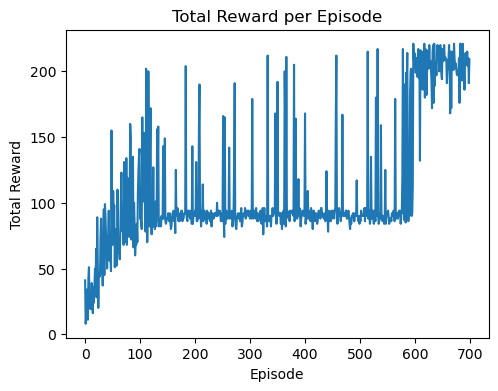

In [71]:
doubleQLearning_agent = DoubleQLearning(env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, num_episodes=700)

double_total_rewards_base = doubleQLearning_agent.train()
plot_results(total_rewards_base)


In [74]:
sarsa_agent = SARSA(env, alpha=0.2, gamma=0.9, epsilon=0.6, epsilon_decay = 0.999, min_epsilon = 0.1, num_episodes=700)

sarsa_total_rewards_base = sarsa_agent.train()

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.5993999999999999
Episode: 0, reward gained: 72, Epsilon value: 0.5993999999999999
Updated Q-table: [[ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.      

Episode: 219, reward gained: 144, Epsilon value: 0.4814582801164151
Updated Q-table: [[ 8.363912    7.20269236  6.46878687  6.42151949 10.58006008  5.33871849
   6.71514846  7.48466824]
 [ 3.44102545  5.58229535  4.29316944  2.10973127 13.03885183  5.07648395
   4.18425974  6.82078378]
 [ 6.61511554  4.30748178  3.61922848  6.01036592 15.46631262  3.73116634
   3.60845153  5.05453939]
 [10.43599121  4.62699877  2.6769903   3.28013831  5.40921219  3.36781915
   6.28804081 14.54491669]
 [ 8.22064851  5.84724289  6.47019331  8.34290281 16.50783744  4.5483827
   5.66610579  7.67290225]
 [15.30008031  6.80601127  8.76349943  6.42805558  9.39512746  6.43411784
   5.56566548  8.49393204]
 [14.86753246  7.75371579 11.30219345  8.55821515 24.67854653  9.13137907
   8.21558807 12.23172608]
 [21.18488106  8.42069093 12.88059964 12.98996812 18.1496256   7.47771075
   5.4799339  15.71577789]
 [13.53099759  9.86782659  9.87509629  6.68144874 10.72890692  6.32520839
   7.2325474   8.89405815]
 [12.78

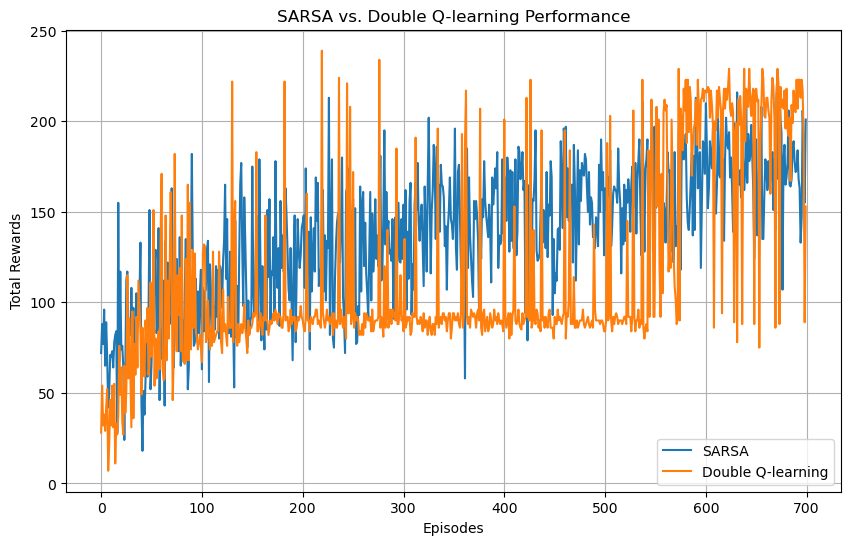

In [75]:
# plot_results(total_rewards_base)
plt.figure(figsize=(10, 6))

# Plot SARSA rewards
plt.plot(sarsa_total_rewards_base, label='SARSA')

# Plot Double Q-learning rewards
plt.plot(double_total_rewards_base, label='Double Q-learning')

plt.title('SARSA vs. Double Q-learning Performance')
plt.xlabel('Episodes')
plt.ylabel('Total Rewards')
plt.legend()
plt.grid(True)
plt.show()

# BONUS

Initial Q-table: [[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]]
0.987
Episode: 0, reward gained: 25.8, Epsilon value: 0.987
Updated Q-table: [[ 0.      0.      0.0342  0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.18    0.      0.    ]
 [ 0.      0.      0.38    0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.38    0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.      0.      0.      0.    ]
 [ 0.      0.      0.      0.      0.45    0.      0.      0.    ]
 [ 0

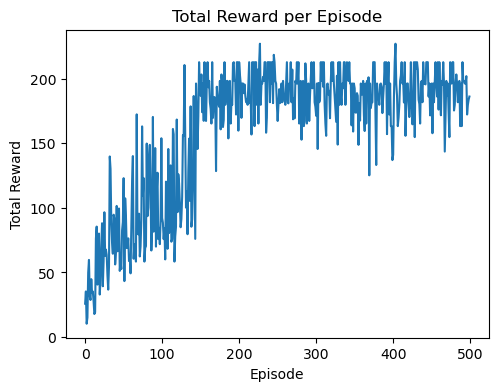

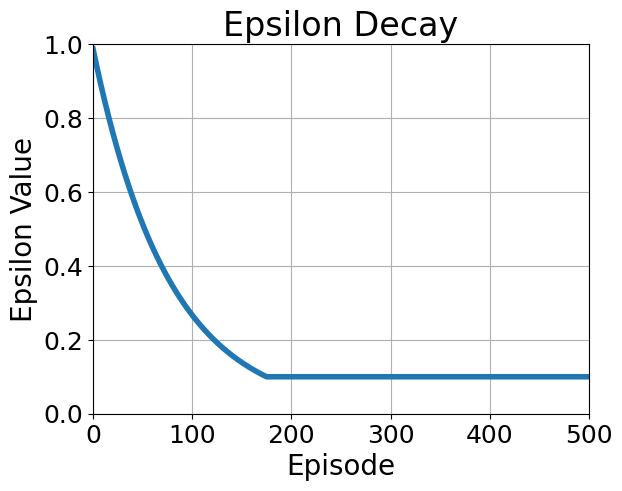

In [32]:
class TwoStepBootstrap:

    def __init__(self, env, alpha=0.1, gamma=0.9, epsilon=1, epsilon_decay = 0.987, min_epsilon = 0.1, step = 2, num_episodes=500):
        self.env = env
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.num_episodes = num_episodes
        self.q_table = np.zeros((env.observation_space.n, env.action_space.n))
        self.epsilon_decay = epsilon_decay
        self.min_epsilon = min_epsilon
        self.epsilon_values = None
        self.step = step

    def epsilon_greedy_policy(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.env.action_space.n)
        else:
            temp = np.argmax(self.q_table[state])
            return temp

    def epsilon_decaying(self):
        return max(self.min_epsilon, self.epsilon * self.epsilon_decay)

    def train(self):
        print(f'Initial Q-table: {self.q_table}')
        total_rewards = []
        self.epsilon_values = []

        for episode in range(self.num_episodes):
            state = self.env.reset()
            current_index = 0
            total_reward = 0
            action = self.epsilon_greedy_policy(current_index)
            current_index = 0
            self.epsilon = self.epsilon_decaying()
            print(self.epsilon)
            while True:
                intermediate_reward = 0
                
                for i in range(self.step):
                    observation, reward, done, truncated, _ = self.env.step(action)
                    intermediate_reward += (self.gamma ** i) * reward

                    if done:
                        break
                        
                next_index = (self.env.agent_position[0] * self.env.GRID_SIZE) + self.env.agent_position[1]

                next_action = self.epsilon_greedy_policy(next_index)
                

                # Q-table update
                self.q_table[current_index, action] += self.alpha * (intermediate_reward + self.gamma * \
                                            self.q_table[next_index, next_action] - self.q_table[current_index, action])

                action = next_action
                current_index = next_index
                total_reward += intermediate_reward

                if done:
                    break
            self.epsilon_values.append(self.epsilon)
            print(f'Episode: {episode}, reward gained: {total_reward}, Epsilon value: {self.epsilon}')
            print(f'Updated Q-table: {self.q_table}')
            total_rewards.append(total_reward)
        
        print(f'Final Q-table: {self.q_table}')

        return total_rewards

def plot_results(total_rewards, epsilon_values=None):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(total_rewards)
    plt.title('Total Reward per Episode')
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')

    if epsilon_values is not None:
        plt.subplot(1, 2, 2)
        plt.plot(epsilon_values)
        plt.title('Epsilon Decay')
        plt.xlabel('Episode')
        plt.ylabel('Epsilon')

    plt.show()

env = RoomVacuum()

bootstrap_agent = TwoStepBootstrap(env)

total_rewards_base = bootstrap_agent.train()

plot_results(total_rewards_base)

epsilon_decay_graph(bootstrap_agent.epsilon_values)

# References

In [50]:
# https://ubuffalo-my.sharepoint.com/personal/avereshc_buffalo_edu/_layouts/15/onedrive.aspx?ga=1&id=%2Fpersonal%2Favereshc%5Fbuffalo%5Fedu%2FDocuments%2F2023%5FFall%5FML%2F%5Fpublic%2FCourse%20Materials%2FRL%20Environment%20Visualization%20by%20Nitin%20Kulkarni%2Fvisualizing%5Frl%5Fenvironments%5Fand%5Frepresenting%5Fthe%5Fresults%20%282%29%2Ezip&parent=%2Fpersonal%2Favereshc%5Fbuffalo%5Fedu%2FDocuments%2F2023%5FFall%5FML%2F%5Fpublic%2FCourse%20Materials%2FRL%20Environment%20Visualization%20by%20Nitin%20Kulkarni

In [51]:
# https://ubuffalo-my.sharepoint.com/personal/avereshc_buffalo_edu/_layouts/15/onedrive.aspx?ga=1&id=%2Fpersonal%2Favereshc%5Fbuffalo%5Fedu%2FDocuments%2F2023%5FFall%5FML%2F%5Fpublic%2FCourse%20Materials%2FRL%20Environment%20Demo%2FRL%5FEnvironment%5FDemo%5Fby%5FAlina%5FVereshchaka%2Eipynb&parent=%2Fpersonal%2Favereshc%5Fbuffalo%5Fedu%2FDocuments%2F2023%5FFall%5FML%2F%5Fpublic%2FCourse%20Materials%2FRL%20Environment%20Demo